# Preference Learning - Part IV (warm)
## 1. Principle Component Analysis (PCA)
## 2. K-mean clustering with/without normalization
## 3. Multiple regression
## 4. Groups' Price Responsiveness

In [2]:
%matplotlib inline
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import json
import seaborn as sns
import math
from pandas.io.json import json_normalize #package for flattening json in pandas df
import matplotlib.pyplot as plt
from datetime import date, timedelta, datetime

## 1. Principle Component Analysis
We first focus on the non-event data. For each hour, 

(1) the first approach is we do principle component analysis and get several explanable top PCs and then use the top PCs to do K-mean clustering to find out groups; 

(2) the second approach is forget about PCA, and start by drawing histogram of distribution on a temp, consumption, occurence 3D space, and using GMM to fit the data and find out the classes.

In [ ]:
# Import all preprocessed data necessary for the analysis
df_tou1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_tou2013_1h.csv")
df_Ntou1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\Consumption_Ntou2013_1h.csv")
df_wea1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\weather\\LondonWeather2013_interpolated.csv")
df_tariff_1h = pd.read_csv("C:\\Users\\Rockwell\\Desktop\\Paper4\\data_collection\\data_tables\\df_tariff_1h.csv")

In [3]:
import os
os.getcwd()

'/Users/Rockwell/Documents/GitHub/Demand-Response'

In [4]:
# for ios system, import all data necessary for the analysis
df_tou1h = pd.read_csv('/Users/Rockwell/Desktop/PhD/Paper4PreferenceLearning/data/Consumption_tou2013_1h.csv')
df_Ntou1h = pd.read_csv('/Users/Rockwell/Desktop/PhD/Paper4PreferenceLearning/data/Consumption_Ntou2013_1h.csv')
df_wea1h = pd.read_csv('/Users/Rockwell/Desktop/PhD/Paper4PreferenceLearning/data/LondonWeather2013_interpolated.csv')
df_tariff_1h = pd.read_csv('/Users/Rockwell/Desktop/PhD/Paper4PreferenceLearning/data/df_tariff_1h.csv')

In [5]:
# first, create a list of days that belongs to event days
event_days = set()
event_series = df_tariff_1h[df_tariff_1h.Event_tags.notnull()].GMT
for i in event_series:
    event_days.add(datetime.strptime(i[:10], "%Y-%m-%d" ).date()) # add all event dates to the set
df_help = pd.DataFrame(pd.to_datetime(df_tariff_1h.GMT).dt.date) #str to datatime and extract date then make it to dataframe
# df_help[df_help['GMT'].isin(event_days)] #this shows the event days
# we can use ~df_help['GMT'].isin(event_days) to generate any non-flexible period items

# create TOU and non-TOU demand data in non-flexible hours
df_wea1h_nf = df_wea1h[~df_help['GMT'].isin(event_days)]
df_Ntou1h_nf = df_Ntou1h[~df_help['GMT'].isin(event_days)]
df_tou1h_nf = df_tou1h[~df_help['GMT'].isin(event_days)]

# create event data
df_tariff_1h_event = df_tariff_1h[df_tariff_1h.GMT.isin(event_series)]
df_wea1h_event = df_wea1h[df_wea1h.GMT.isin(event_series)]
df_tou1h_event = df_tou1h[df_tou1h.GMT.isin(event_series)]

In [6]:
# seperate the above data set based on the seasonal effect
# i.e., months of 11, 12, 1, 2, 3 are in a group - cold season
# months of 4, 5, 6, 7, 8, 9, 10 are in another group - warm season
cold_season = [11, 12, 1, 2, 3]
warm_season = [4, 5, 6, 7, 8, 9, 10]
df_help_season = pd.DataFrame(pd.to_datetime(df_wea1h_nf.GMT).dt.month)
df_wea1h_nf_cold = df_wea1h_nf[df_help_season['GMT'].isin(cold_season)]
df_wea1h_nf_warm = df_wea1h_nf[df_help_season['GMT'].isin(warm_season)]
df_Ntou1h_nf_cold = df_Ntou1h_nf[df_help_season['GMT'].isin(cold_season)]
df_Ntou1h_nf_warm = df_Ntou1h_nf[df_help_season['GMT'].isin(warm_season)]
df_tou1h_nf_cold = df_tou1h_nf[df_help_season['GMT'].isin(cold_season)]
df_tou1h_nf_warm = df_tou1h_nf[df_help_season['GMT'].isin(warm_season)]

df_help_season_event = pd.DataFrame(pd.to_datetime(df_wea1h_event.GMT).dt.month)
df_wea1h_event_cold = df_wea1h_event[df_help_season_event['GMT'].isin(cold_season)]
df_wea1h_event_warm = df_wea1h_event[df_help_season_event['GMT'].isin(warm_season)]
df_tou1h_event_cold = df_tou1h_event[df_help_season_event['GMT'].isin(cold_season)]
df_tou1h_event_warm = df_tou1h_event[df_help_season_event['GMT'].isin(warm_season)]
df_tariff_1h_event_cold = df_tariff_1h_event[df_help_season_event['GMT'].isin(cold_season)]
df_tariff_1h_event_warm = df_tariff_1h_event[df_help_season_event['GMT'].isin(warm_season)]

(0) Some basic temperature distribution of the two groups are given below

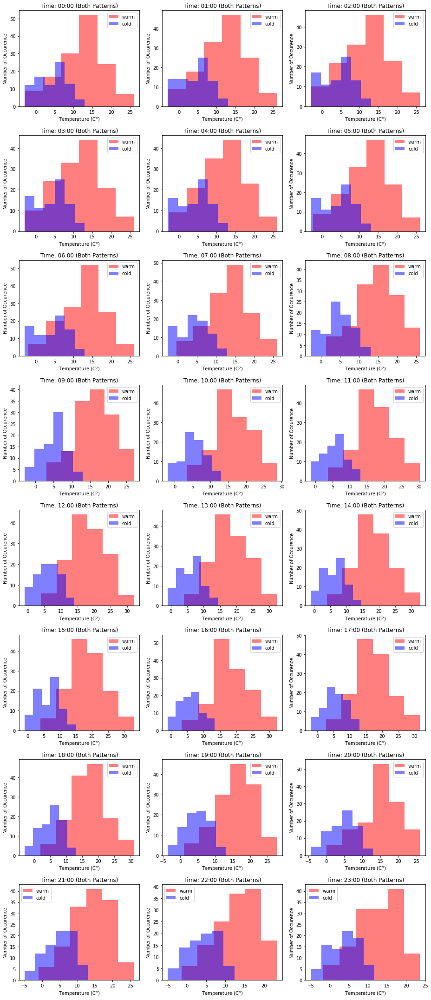

In [6]:
# temperature distribution of different hours of a day in a year
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        ax.hist(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['TempC'], bins=6, color = 'red', alpha = 0.5, label = 'warm')
        ax.hist(df_wea1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains('0' + str(i) + ':00:00')]['TempC'], bins=6, color = 'blue', alpha = 0.5, label = 'cold')
        ax.set_title('Time: 0' + str(i) + ':00' + ' (Both Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Number of Occurence')
    else:
        ax.hist(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['TempC'], bins=6, color = 'red', alpha = 0.5, label = 'warm')
        ax.hist(df_wea1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains(str(i) + ':00:00')]['TempC'], bins=6, color = 'blue', alpha = 0.5, label = 'cold')
        ax.set_title('Time: ' + str(i) + ':00' + ' (Both Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Number of Occurence')
plt.tight_layout()

(1) In PCA, we don't consider normalization since all the consumptions have the same unit, we care about the absolute change rather than relative change since DR targets the customer who has largest potential shiftable load instead of largest price-responsiveness rate. Also we have seperate data by hours, so the temp-consumption relationship at different hours has been treated seprately and equally, so the time effect won't be a concern to let us normalize the data.

In [7]:
df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('09:00:00')].transpose()

,2169,2193,2217,2241,2289,2313,2361,2385,2433,2481,...,6825,7065,7089,7113,7137,7161,7185,7209,7233,7257
GMT,2013-04-01 09:00:00,2013-04-02 09:00:00,2013-04-03 09:00:00,2013-04-04 09:00:00,2013-04-06 09:00:00,2013-04-07 09:00:00,2013-04-09 09:00:00,2013-04-10 09:00:00,2013-04-12 09:00:00,2013-04-14 09:00:00,...,2013-10-12 09:00:00,2013-10-22 09:00:00,2013-10-23 09:00:00,2013-10-24 09:00:00,2013-10-25 09:00:00,2013-10-26 09:00:00,2013-10-27 09:00:00,2013-10-28 09:00:00,2013-10-29 09:00:00,2013-10-30 09:00:00
D0000,0.11,0.063,0.178,0.528,0.089,0.351,0.218,0.101,0.425,0.079,...,0.072,0.317,0.104,0.276,0.729,0.081,0.056,0.083,0.084,0.058
D0001,0.197,0.223,0.06,0.293,0.148,0.138,0.152,0.158,0.248,0.162,...,0.125,0.274,0.132,0.233,0.344,0.269,0.189,0.306,0.295,0.375
D0002,2.787,0.979,1.644,0.402,0.697,1.273,1.715,2.663,1.392,1.196,...,1.309,0.171,0.374,0.412,0.516,1.195,1.192,0.614,1.46,1.835
D0003,0.148,0.144,0.324,0.143,0.148,1.059,0.147,0.152,0.156,1.187,...,0.16,0.168,0.179,0.163,0.163,0.333,0.535,0.169,0.099,0.099
D0004,0.307,0.461,0.23,0.429,0.404,0.488,0.455,0.238,0.242,0.912,...,0.279,0.142,0.34,0.365,0.284,0.19,0.268,0.253,0.215,0.208
D0005,0.343,0.287,0.223,0.422,0.37,0.373,0.347,0.29,0.343,0.244,...,0.476,0.181,0.269,0.297,0.436,0.324,0.786,0.274,0.338,0.387
D0006,0.84,0.181,0.149,0.702,0.096,0.131,0.25,0.767,0.285,0.098,...,0.194,0.286,0.376,0.333,0.048,0.919,0.143,0.228,0.499,0.184
D0007,0.342,0.209,0.293,0.787,0.288,0.506,0.322,0.273,0.288,0.559,...,1.012,0.187,0.873,0.231,0.227,0.263,0.272,0.238,0.175,0.79
D0008,0.104,0.126,0.124,0.288,0.098,0.576,0.171,0.257,0.121,1.002,...,0.258,0.129,0.129,0.177,0.131,0.109,0.267,0.313,0.263,0.178


In [8]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
# Test with 9:00 am TOU data
x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('09:00:00')]
x.set_index('GMT', inplace = True)
x = x.transpose().dropna() # data for the specific hour, and filtering out null value
x = x.values
x = StandardScaler().fit_transform(x)
pca = PCA()# keep all columns to cover 100% variance
principleComponents = pca.fit_transform(x)
principleDf = pd.DataFrame(data = principleComponents)
principleDf

,0,1,2,3,4,5,6,7,8,9,...,129,130,131,132,133,134,135,136,137,138
0,-4.512222,1.015687,-0.355179,-0.436117,-0.189375,1.374784,-1.288974,1.202487,0.761967,0.469236,...,1.071673,-0.334344,-0.501925,-0.328486,-0.189900,-0.125163,0.268486,-0.238904,0.211695,-0.104427
1,-3.046918,-0.430773,-0.309117,0.136009,0.278526,-0.077276,-0.847145,-0.863169,-0.471936,0.135650,...,-0.303065,-0.451450,-0.388934,0.175736,-0.201339,0.098013,0.116432,-0.179523,0.201419,0.014553
2,11.478668,5.324820,1.575769,0.353479,1.342200,1.226339,2.637426,0.257290,-4.632804,-0.125207,...,-0.404059,0.921504,0.097183,-0.141940,-0.069002,-0.037292,-0.453465,0.072177,0.250670,0.388206
3,-1.340653,4.430653,-0.857014,0.946635,-0.013841,-3.105843,-1.606426,-0.334299,-2.430122,-1.553990,...,0.060032,0.197364,-0.016278,-0.387620,0.713357,0.187156,-0.195938,0.094460,0.344399,0.178642
4,-6.190426,1.171094,1.754095,0.380849,0.191071,0.198235,-0.048337,0.178417,-0.554229,-0.123905,...,-0.082153,-0.205246,-0.003990,-0.071642,0.477306,-0.185308,-0.335830,0.030576,-0.246181,-0.101742
5,-1.231413,-0.350828,-0.673411,-0.177436,-0.480530,-0.172093,-0.079046,0.023071,-0.015000,-0.037657,...,0.071770,0.079443,-0.510231,0.113367,-0.220947,0.240066,-0.028409,-0.164400,-0.177257,-0.273524
6,-0.295792,-0.968340,-0.555583,0.130429,-0.483096,2.060626,-0.761686,0.080714,0.291958,-0.351315,...,0.646844,-0.403901,0.068946,-0.139175,-0.722631,0.662446,0.495062,0.310741,-0.274915,0.434014
7,-1.355168,-0.249267,0.361870,-0.080553,-0.341466,0.402250,-0.288570,-1.010213,1.124667,0.435958,...,0.143460,-0.840537,-0.154227,-0.828802,1.035082,0.115332,-0.198199,0.572171,-0.346487,-0.016845
8,-5.339566,-0.349525,-0.238231,0.127173,-0.617952,-0.300913,0.085161,0.034700,0.093144,-0.602490,...,-0.063281,0.036946,0.013117,-0.244578,0.369042,-0.083719,-0.053825,0.009869,0.183378,0.325213
9,1.594617,3.759965,-1.263836,2.478668,-1.564113,0.212554,-2.305600,-2.726842,-1.465381,-0.982981,...,1.073802,-0.251852,0.569669,-0.064974,0.285510,-0.137444,0.518236,-0.186941,0.133476,0.353828


Note: in cold seasons non-null value users are 958, which is more than these in the warm seasons.

In [15]:
sum(x[:,0])

4.796163466380676e-14

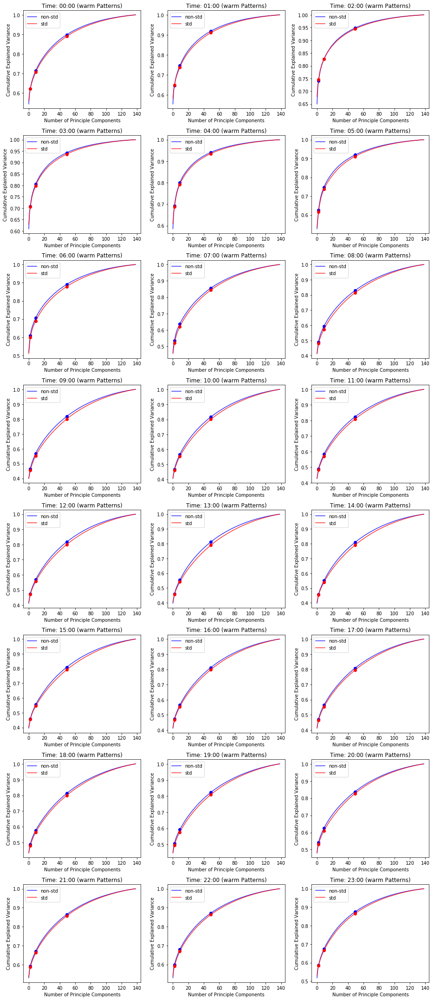

In [9]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.plot(np.cumsum(pca_nstd.explained_variance_ratio_), c = 'blue', label = 'non-std', alpha = 0.8)
        ax.plot([2, 9, 49], [np.cumsum(pca_nstd.explained_variance_ratio_)[2], np.cumsum(pca_nstd.explained_variance_ratio_)[9], np.cumsum(pca_nstd.explained_variance_ratio_)[49]], 'bo')
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.plot(np.cumsum(pca.explained_variance_ratio_), c = 'red', label = 'std', alpha = 0.8)
        ax.plot([2, 9, 49], [np.cumsum(pca.explained_variance_ratio_)[2], np.cumsum(pca.explained_variance_ratio_)[9], np.cumsum(pca.explained_variance_ratio_)[49]], 'ro')
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Number of Principle Components')
        ax.set_ylabel('Cumulative Explained Variance')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.plot(np.cumsum(pca_nstd.explained_variance_ratio_), c = 'blue', label = 'non-std', alpha = 0.8)
        ax.plot([2, 9, 49], [np.cumsum(pca_nstd.explained_variance_ratio_)[2], np.cumsum(pca_nstd.explained_variance_ratio_)[9], np.cumsum(pca_nstd.explained_variance_ratio_)[49]], 'bo')
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.plot(np.cumsum(pca.explained_variance_ratio_), c = 'red', label = 'std', alpha = 0.8)
        ax.plot([2, 9, 49], [np.cumsum(pca.explained_variance_ratio_)[2], np.cumsum(pca.explained_variance_ratio_)[9], np.cumsum(pca.explained_variance_ratio_)[49]], 'ro')
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Number of Principle Components')
        ax.set_ylabel('Cumulative Explained Variance')
plt.tight_layout()

The above pictures show that using the first 3 PCs can always explain from 45% to 74% amount of variance. 

Next we will give the meaning of the first 3 PCs:

PC1 & PC2: temperature related (no matter of standarization, PC1 and PC2 are somehow correlated)

PC3: related to days of week, since the coeffients of Friday and Saturday are skewied to positive area, if there's not correlation, it should always be equally distributed around 0

Using the 3 components to do k-mean clustering and we can get several groups

Coloring them in a 3D space (or if the first two PCs leads to some confustion, maybe do 2D with 3 differnt projections)

Then we could try to color them in a 2D slice surphase (temp vs day of week, temp )


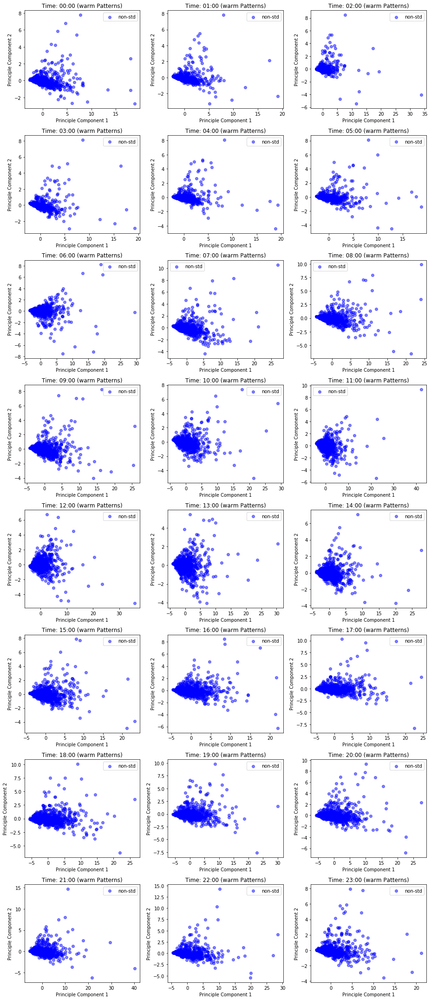

In [10]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(principleDf_nstd[0], principleDf_nstd[1], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
#         ax.scatter(principleDf[0], principleDf[1], c = 'red', label = 'std', alpha = 0.1)
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 2')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(principleDf_nstd[0], principleDf_nstd[1], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
#         ax.scatter(principleDf[0], principleDf[1], c = 'red', label = 'std', alpha = 0.1)
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 2')
plt.tight_layout()

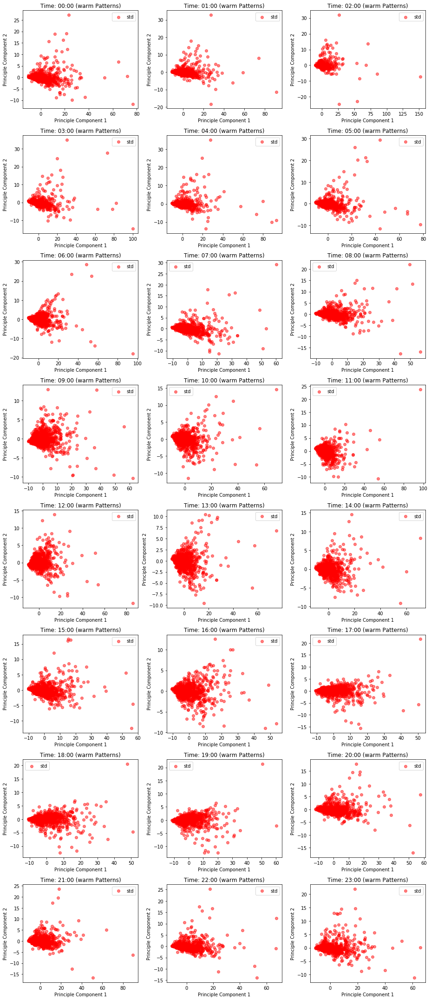

In [11]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         ax.scatter(principleDf_nstd[0], principleDf_nstd[1], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.scatter(principleDf[0], principleDf[1], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 2')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         ax.scatter(principleDf_nstd[0], principleDf_nstd[1], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.scatter(principleDf[0], principleDf[1], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 2')
plt.tight_layout()

Different from the size-and-variable both standardization in paper 2, we care about the size effect. So we do not perform size standardization. Also in paper2, the author worried about the correlated problems, which wouldn't appear if they didn't use the no-size-scaled PCA to perform K-mean clustering. So the reason that problem seems to exist is they used the different PCA as the input of K-mean clustering and get the different labels, then put these labels to the previous PCA method, it seems that in Fig2 of their paper, each "category" seems has PC1 and PC2 linearly correlated, but this problem shouldn't have.

Component 1 and Component 3 relationship is shown below

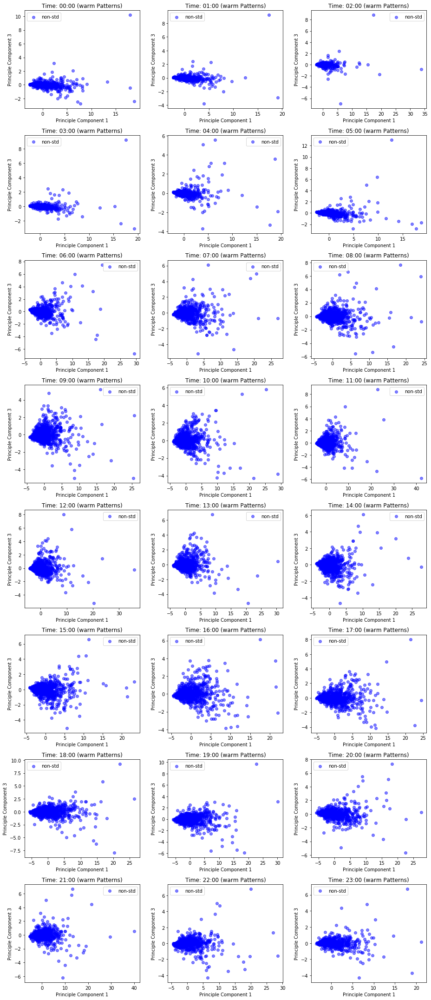

In [12]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(principleDf_nstd[0], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
#         ax.scatter(principleDf[0], principleDf[2], c = 'red', label = 'std', alpha = 0.1)
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 3')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(principleDf_nstd[0], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
#         ax.scatter(principleDf[0], principleDf[2], c = 'red', label = 'std', alpha = 0.1)
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 3')
plt.tight_layout()

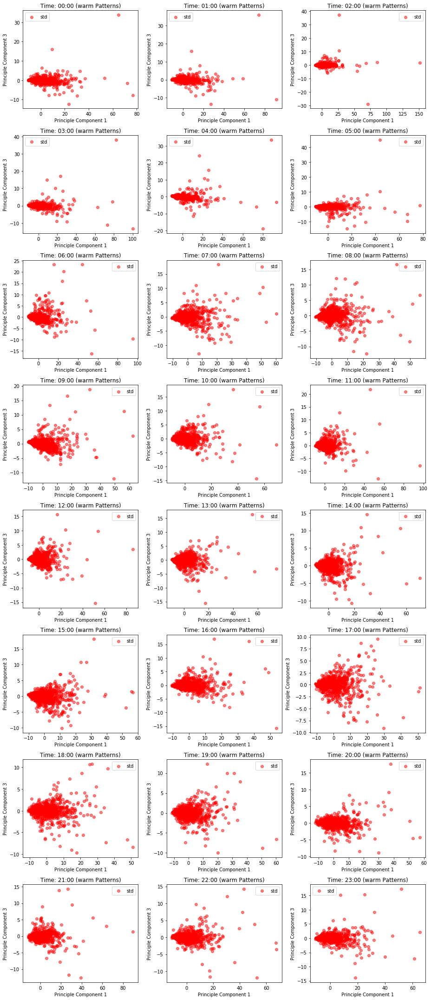

In [13]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         ax.scatter(principleDf_nstd[0], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.scatter(principleDf[0], principleDf[2], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 3')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         ax.scatter(principleDf_nstd[0], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.scatter(principleDf[0], principleDf[2], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 1')
        ax.set_ylabel('Principle Component 3')
plt.tight_layout()

Component 2 and Component 3 relationship is shown below

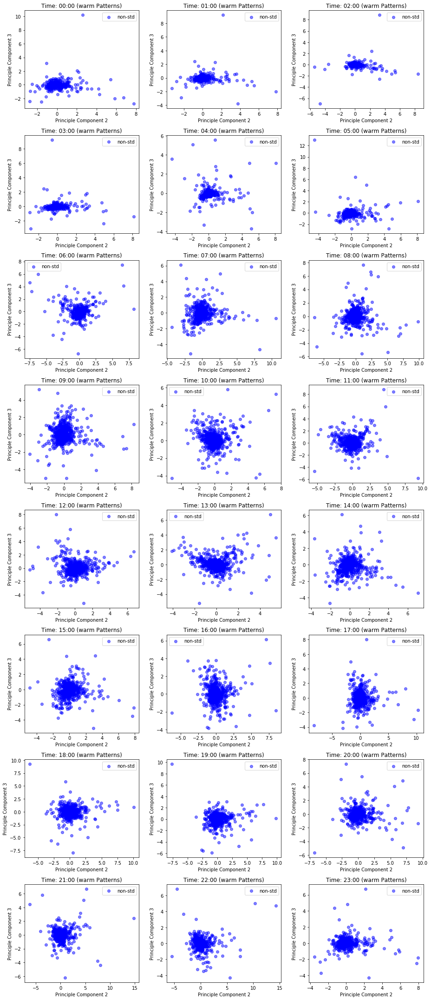

In [14]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(principleDf_nstd[1], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
#         ax.scatter(principleDf[1], principleDf[2], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 2')
        ax.set_ylabel('Principle Component 3')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(principleDf_nstd[1], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
#         ax.scatter(principleDf[1], principleDf[2], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 2')
        ax.set_ylabel('Principle Component 3')
plt.tight_layout()

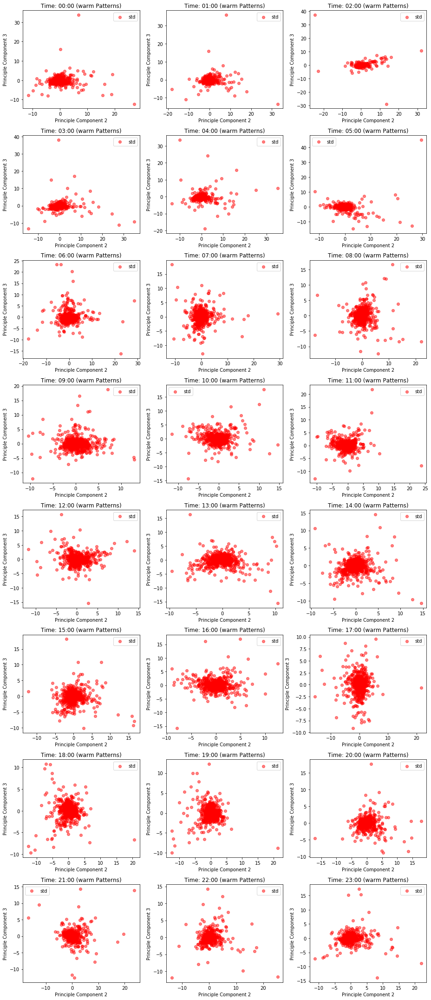

In [15]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         ax.scatter(principleDf_nstd[1], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.scatter(principleDf[1], principleDf[2], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 2')
        ax.set_ylabel('Principle Component 3')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         ax.scatter(principleDf_nstd[1], principleDf_nstd[2], c = 'blue', label = 'non-std', alpha = 0.5)
        # PCA with standardization
        x = x.values
        x = StandardScaler().fit_transform(x)
        pca = PCA()# keep all columns to cover 100% variance
        principleComponents = pca.fit_transform(x)
        principleDf = pd.DataFrame(data = principleComponents)
        ax.scatter(principleDf[1], principleDf[2], c = 'red', label = 'std', alpha = 0.5)
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Principle Component 2')
        ax.set_ylabel('Principle Component 3')
plt.tight_layout()

The above three types of plots show that std don't have significant advantage in this case, so we will use non-std in our later analysis.

Let's try to interprete PCs' meaning: 

(1) PC1's coefficients vs Temperature:

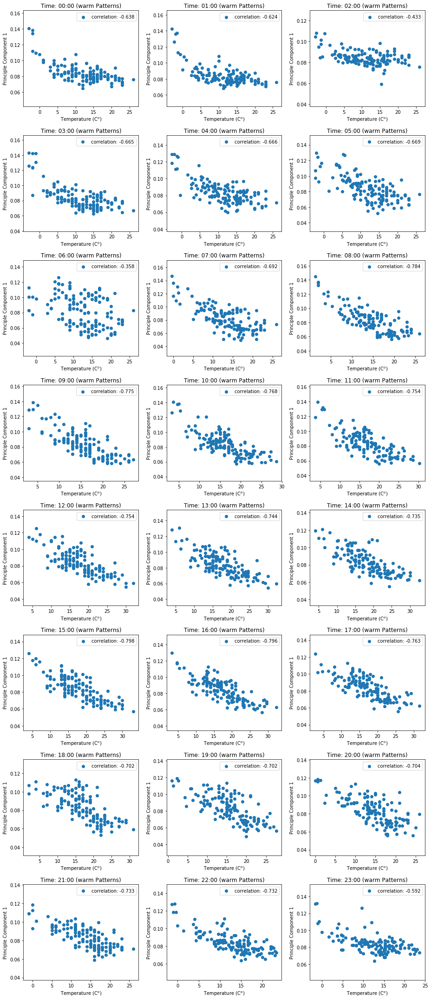

In [16]:
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')], pca_nstd.components_[0], label = 'correlation: ' + str(round(np.corrcoef(pca_nstd.components_[0], df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')])[0][1], 3)))
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Principle Component 1')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')], pca_nstd.components_[0], label = 'correlation: ' + str(round(np.corrcoef(pca_nstd.components_[0], df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')])[0][1], 3)))
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Principle Component 1')
plt.tight_layout()

2) PC2's coefficients  vs Temperature:

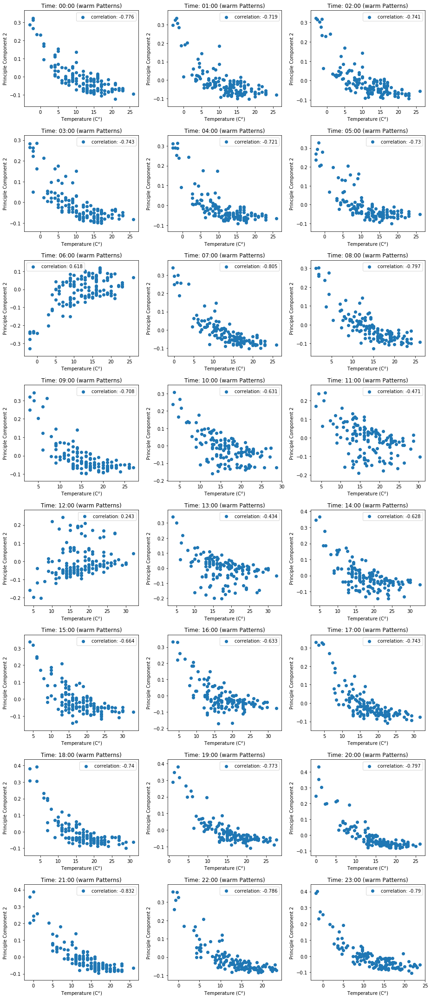

In [17]:
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')], pca_nstd.components_[1], label = 'correlation: ' + str(round(np.corrcoef(pca_nstd.components_[1], df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')])[0][1], 3)))
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Principle Component 2')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')], pca_nstd.components_[1], label = 'correlation: ' + str(round(np.corrcoef(pca_nstd.components_[1], df_wea1h_nf_warm.TempC[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')])[0][1], 3)))
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Principle Component 2')
plt.tight_layout()

The above figures show that PC2 still has certain amount of correlation with temperature but not as significant as PC1 and temperature have.

3) PC3's coefficients vs Day of a Week:

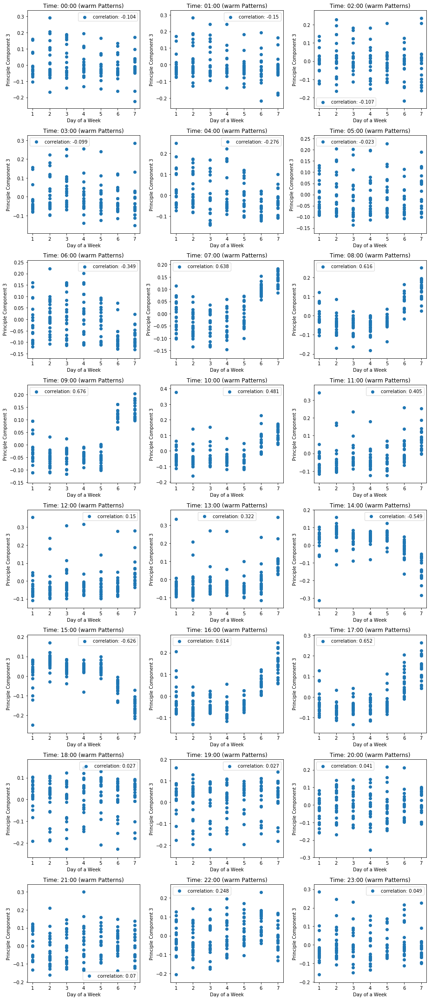

In [18]:
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        dayofWeek= pd.DataFrame(pd.to_datetime(x.GMT).dt.dayofweek)
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(dayofWeek + 1, pca_nstd.components_[2], label = 'correlation: ' + str(round(np.corrcoef(pca_nstd.components_[2], dayofWeek.GMT)[0][1], 3)))
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Day of a Week')
        ax.set_ylabel('Principle Component 3')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        dayofWeek= pd.DataFrame(pd.to_datetime(x.GMT).dt.dayofweek)
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        ax.scatter(dayofWeek + 1, pca_nstd.components_[2], label = 'correlation: ' + str(round(np.corrcoef(pca_nstd.components_[2], dayofWeek.GMT)[0][1], 3)))
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel('Day of a Week')
        ax.set_ylabel('Principle Component 3')
plt.tight_layout()

## 2. K-mean clustering
Milestone 4: K-mean clustering

The first three PCs are selected as inputs for K-mean clustering, due to their significance and interpretability

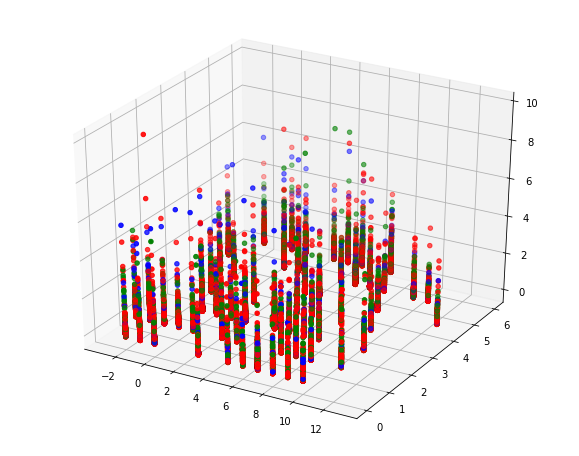

In [431]:
x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]
t = x.dropna(axis = 'columns')
t2 = t[t.columns[np.insert(kmeans.labels_ == 0, 0, True)]].copy() # select all data from the n-th cluster
t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['TempC'].values) # add temperature column to dataframe
t2['DayofWeek'] = pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['GMT']).dt.dayofweek # add day of a week column to dataframe
t2
fig_all = plt.figure(figsize = (10,8))
ax = fig_all.add_subplot(1, 1, 1, projection = '3d')
for i in range(1, 1 + 528):
    ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[i]], color = 'red')

t2 = t[t.columns[np.insert(kmeans.labels_ == 1, 0, True)]].copy() # select all data from the n-th cluster
t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['TempC'].values) # add temperature column to dataframe
t2['DayofWeek'] = pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['GMT']).dt.dayofweek # add day of a week column to dataframe
for i in range(1, 1 + 107):
    ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[i]], color = 'green')
    
t2 = t[t.columns[np.insert(kmeans.labels_ == 2, 0, True)]].copy() # select all data from the n-th cluster
t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['TempC'].values) # add temperature column to dataframe
t2['DayofWeek'] = pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['GMT']).dt.dayofweek # add day of a week column to dataframe
for i in range(1, 1 + 25):
    ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[i]], color = 'blue')

In [424]:
# the first groups consumption dataframe

(kmeans.labels_ == 2).sum()

25

In [ ]:
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1, projection = '3d')
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        dayofWeek= pd.DataFrame(pd.to_datetime(x.GMT).dt.dayofweek)
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = 3).fit(principleDf_nstd.iloc[:,:3])
        ax.scatter(principleDf_nstd[1], principleDf_nstd[2], principleDf_nstd[0], c = (kmeans.labels_*10), cmap = 'rainbow')
        # what is the center of the cluster
        kmeans.cluster_centers_
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.set_xlabel('PC2')
        ax.set_ylabel('PC3')
        ax.set_zlabel('PC1')
#     else:
#         x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
#         dayofWeek= pd.DataFrame(pd.to_datetime(x.GMT).dt.dayofweek)
#         x.set_index('GMT', inplace = True)
#         x = x.transpose().dropna() # data for the specific hour, and filtering out null value
#         # PCA without standardization
#         pca_nstd = PCA()
#         principleComponents_nstd = pca_nstd.fit_transform(x)
#         principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
#         kmeans = KMeans(n_clusters = 3).fit(principleDf_nstd.iloc[:,:3])
#         ax.scatter(principleDf_nstd[1], principleDf_nstd[2], principleDf_nstd[0], c = (kmeans.labels_*10), cmap = 'rainbow')
#         ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
#         ax.set_xlabel('PC2')
#         ax.set_ylabel('PC3')
#         ax.set_zlabel('PC1')
plt.tight_layout()

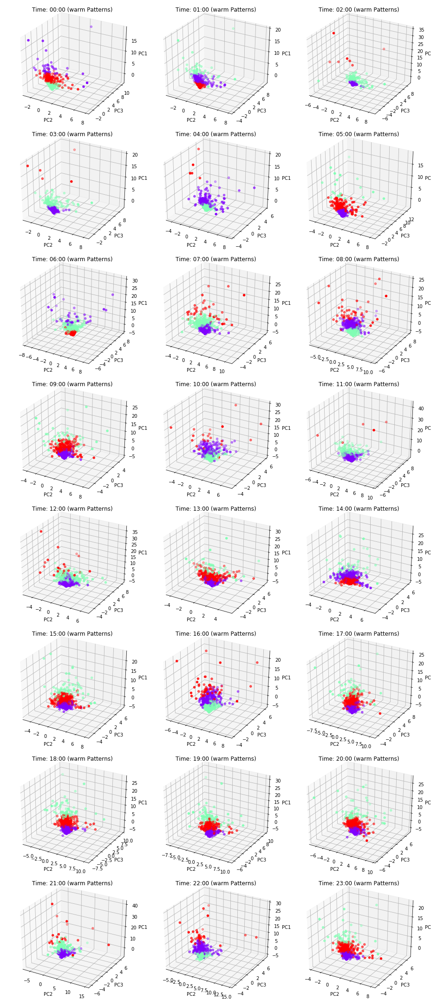

In [20]:
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1, projection = '3d')
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        dayofWeek= pd.DataFrame(pd.to_datetime(x.GMT).dt.dayofweek)
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = 3).fit(principleDf_nstd.iloc[:,:3])
        ax.scatter(principleDf_nstd[1], principleDf_nstd[2], principleDf_nstd[0], c = (kmeans.labels_*10), cmap = 'rainbow')
        # what is the center of the cluster
        kmeans.cluster_centers_
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.set_xlabel('PC2')
        ax.set_ylabel('PC3')
        ax.set_zlabel('PC1')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        dayofWeek= pd.DataFrame(pd.to_datetime(x.GMT).dt.dayofweek)
        x.set_index('GMT', inplace = True)
        x = x.transpose().dropna() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = 3).fit(principleDf_nstd.iloc[:,:3])
        ax.scatter(principleDf_nstd[1], principleDf_nstd[2], principleDf_nstd[0], c = (kmeans.labels_*10), cmap = 'rainbow')
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.set_xlabel('PC2')
        ax.set_ylabel('PC3')
        ax.set_zlabel('PC1')
plt.tight_layout()

The ways of checking the clustering theta threshold condition

In [323]:
kmeans.cluster_centers_[1]

array([13.69917824,  0.46278999, -0.14054859])

In [348]:
np.square(kmeans.cluster_centers_[1]).sum() * 0.2

37.580282564512224

In [324]:
principleDf_nstd.iloc[kmeans.labels_ == 1][2].mean()

-0.14054858878175358

In [366]:
(7+189+441)/976

0.6526639344262295

In [379]:
test = principleDf_nstd.iloc[kmeans.labels_ == 0][[0,1,2]] - kmeans.cluster_centers_[0]
sum(np.square(test).sum(axis = 1) > np.square(kmeans.cluster_centers_[0]).sum() * 0.2)

0

In [385]:
test = principleDf_nstd.iloc[kmeans.labels_ == 1][[0,1,2]] - kmeans.cluster_centers_[1]
sum(np.square(test).sum(axis = 1) > np.square(kmeans.cluster_centers_[1]).sum() * 0.2)

63

In [384]:
test = principleDf_nstd.iloc[kmeans.labels_ == 2][[0,1,2]] - kmeans.cluster_centers_[2]
sum(np.square(test).sum(axis = 1) > np.square(kmeans.cluster_centers_[2]).sum() * 0.2)

118

In [383]:
test = principleDf_nstd.iloc[kmeans.labels_ == 3][[0,1,2]] - kmeans.cluster_centers_[3]
sum(np.square(test).sum(axis = 1) > np.square(kmeans.cluster_centers_[3]).sum() * 0.2)

1

In [395]:
tot = 0
for i in range(50):
    test = principleDf_nstd.iloc[kmeans.labels_ == i][[0,1,2]] - kmeans.cluster_centers_[i]
    tot = tot + sum(np.square(test).sum(axis = 1) > np.square(kmeans.cluster_centers_[i]).sum() * 0.2)
tot

184

In [359]:
kmeans.cluster_centers_[2]

array([-1.85445773,  0.06602678, -0.00851691])

General consumptions distribution property of each cluster at each hour

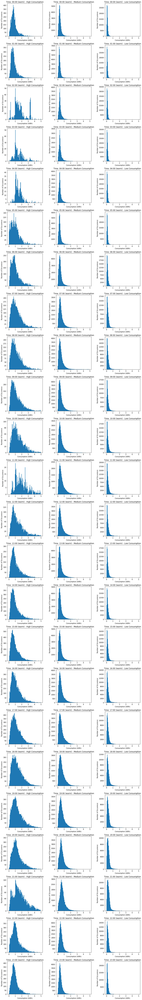

In [21]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
fig_all = plt.figure(figsize = (13,90))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        for k in range(n):
            ax = fig_all.add_subplot(24, 3, i * 3 + k + 1)
            t2 = t[t.columns[kmeans.labels_ == sorted_label[k][0]]].copy() # select all data from the n-th cluster
            t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['TempC'].values) # add temperature column to dataframe
            ax.hist(t2[t2.columns[1:-1]].values.flatten(), bins=100, range=(0,5))
            ax.set_title('Time: 0' + str(i) + ':00' + ' (warm) - ' + str(cons_type[k]))
            ax.set_xlabel('Consumption (kWh)')
            ax.set_ylabel('Number of Occurence')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        for k in range(n):
            ax = fig_all.add_subplot(24, 3, i * 3 + k + 1)
            t2 = t[t.columns[kmeans.labels_ == sorted_label[k][0]]].copy() # select all data from the n-th cluster
            t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['TempC'].values) # add temperature column to dataframe
            ax.hist(t2[t2.columns[1:-1]].values.flatten(), bins=100, range=(0,5))
            ax.set_title('Time: ' + str(i) + ':00' + ' (warm) - ' + str(cons_type[k]))
            ax.set_xlabel('Consumption (kWh)')
            ax.set_ylabel('Number of Occurence')
plt.tight_layout()

General days of a week distribution property of each cluster at each hour

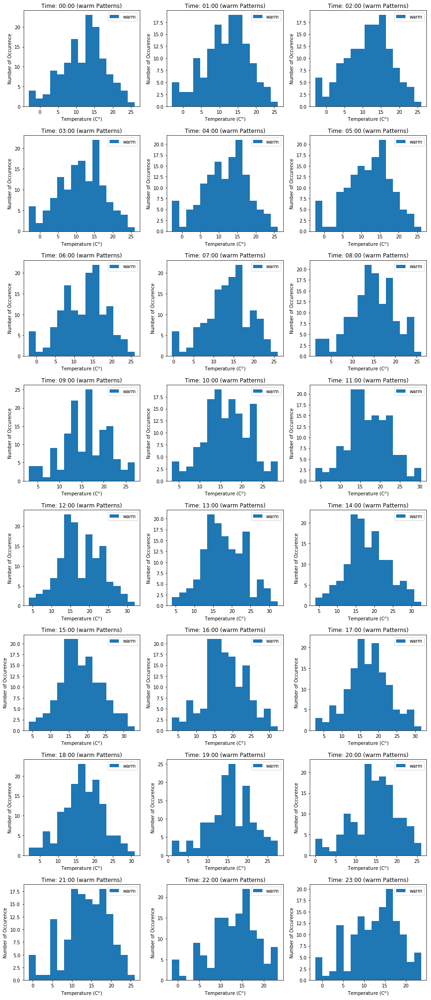

In [22]:
# temperature distribution of different hours of a day in a year
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    ax = fig_all.add_subplot(8, 3, i + 1)
    if i <= 9:
        ax.hist(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['TempC'], bins=15, label = 'warm')
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Number of Occurence')
    else:
        ax.hist(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['TempC'], bins=15, label = 'warm')
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm Patterns)')
        ax.legend()
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Number of Occurence')
plt.tight_layout()

The distribution of days of a week (since it's non-event days, so it's worth checking this property)

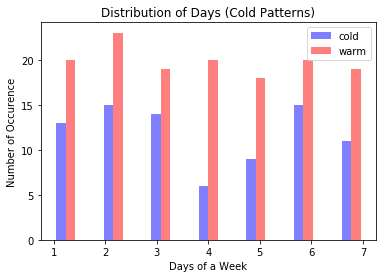

In [24]:
# temperature distribution of different hours of a day in a year
fig_all = plt.figure(figsize = (6,4))
ax = fig_all.add_subplot(1, 1, 1)
ax.hist([pd.to_datetime(df_wea1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains('00:00:00')]['GMT']).dt.dayofweek + 1, 
         pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('00:00:00')]['GMT']).dt.dayofweek + 1], bins=13, alpha = 0.5, color = ['blue', 'red'], label = ['cold', 'warm'])
ax.set_title('Distribution of Days' + ' (Cold Patterns)')
ax.legend()
ax.set_xlabel('Days of a Week')
ax.set_ylabel('Number of Occurence')
plt.show()

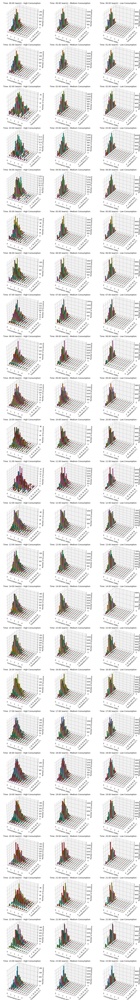

In [25]:
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
fig_all = plt.figure(figsize = (13,90))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        for k in range(n):
            ax = fig_all.add_subplot(24, 3, i * 3 + k + 1, projection = '3d')
            t2 = t[t.columns[kmeans.labels_ == sorted_label[k][0]]].copy() # select all data from the n-th cluster
            t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['TempC'].values) # add temperature column to dataframe
            temp_list = list(set(t2['TempC']))
            temp_list.sort(reverse = True)
            for temp in temp_list:
                t3 = t2[t2['TempC'] == temp] # select the data with a specific temperature
                t3 = np.histogram(t3[t3.columns[1:-1]].values.flatten(), bins=10, range=(0,5))
                xpos = t3[1][:-1]
                ypos = np.ones(10) * temp
                num_elements = len(xpos)
                zpos = np.zeros(num_elements)
                dx = np.ones(10) * 0.15
                dy = np.ones(10) * 0.5
                dz = t3[0]
                pl = ax.bar3d(xpos, ypos, zpos, dx, dy, dz, alpha = 0.5, zsort='max')
                pl._sort_zpos = i * 3 + k + 1
            ax.set_title('Time: 0' + str(i) + ':00' + ' (warm) - ' + str(cons_type[k]))
            ax.set_xlabel('Consumption (kWh)')
            ax.set_ylabel(r'Temperature (C$^o$)')
            ax.set_zlabel('Number of Occurence')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        for k in range(n):
            ax = fig_all.add_subplot(24, 3, i * 3 + k + 1, projection = '3d')
            t2 = t[t.columns[kmeans.labels_ == sorted_label[k][0]]].copy() # select all data from the n-th cluster
            t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['TempC'].values) # add temperature column to dataframe
            temp_list = list(set(t2['TempC']))
            temp_list.sort(reverse = True)
            for temp in temp_list:
                t3 = t2[t2['TempC'] == temp] # select the data with a specific temperature
                t3 = np.histogram(t3[t3.columns[1:-1]].values.flatten(), bins=10, range=(0,5))
                xpos = t3[1][:-1]
                ypos = np.ones(10) * temp
                num_elements = len(xpos)
                zpos = np.zeros(num_elements)
                dx = np.ones(10) * 0.15
                dy = np.ones(10) * 0.5
                dz = t3[0]
                pl = ax.bar3d(xpos, ypos, zpos, dx, dy, dz, alpha = 0.5, zsort='max')
                pl._sort_zpos = i * 3 + k + 1
            ax.set_title('Time: ' +str(i) + ':00' + ' (warm) - ' + str(cons_type[k]))
            ax.set_xlabel('Consumption (kWh)')
            ax.set_ylabel(r'Temperature (C$^o$)')
            ax.set_zlabel('Number of Occurence')
plt.tight_layout()

Most of the above plots show that the highest demand of each group happens around 21-22 celcius degree

In [40]:
t

,D0000,D0001,D0002,D0003,D0004,D0005,D0006,D0007,D0008,D0009,...,D1015,D1016,D1017,D1018,D1019,D1020,D1021,D1022,D1023,D1024
GMT,,,,,,,,,,,,,,,,,,,,,
2013-01-01 00:00:00,1.447,0.429000,0.451,0.155,0.397,0.106,0.307,0.268,0.390,0.123,...,0.048,0.033,0.502,0.117,0.378,1.143,0.155,0.343,0.176,0.117
2013-01-02 00:00:00,0.358,0.153000,0.463,0.169,0.356,0.255,0.436,0.364,0.167,0.104,...,0.061,0.027,0.605,0.673,0.348,0.574,0.111,0.331,0.328,0.146
2013-01-03 00:00:00,0.142,0.385000,0.463,0.154,0.476,0.425,0.829,0.349,0.111,0.435,...,0.080,0.088,0.272,0.093,0.551,0.335,0.093,0.360,0.197,0.342
2013-01-05 00:00:00,0.230,0.137000,0.421,0.156,0.062,0.323,0.498,0.234,0.501,0.202,...,0.045,0.010,0.317,0.096,0.232,0.525,0.087,0.357,0.173,0.137
2013-01-06 00:00:00,0.303,0.229000,0.468,0.158,0.075,0.275,0.467,0.313,0.522,0.403,...,0.185,0.010,0.268,0.105,0.425,0.321,0.242,0.357,0.183,0.206
2013-01-09 00:00:00,0.086,0.330000,0.250,0.156,0.064,0.397,0.418,0.295,0.512,0.221,...,0.067,0.010,0.454,0.091,0.209,0.481,0.092,0.345,0.188,0.196
2013-01-12 00:00:00,0.218,0.317000,0.410,0.149,0.055,0.451,0.410,0.234,0.428,0.285,...,0.083,0.010,0.369,0.089,0.569,0.519,0.094,0.346,0.233,0.393
2013-01-14 00:00:00,0.220,0.120000,0.288,0.147,0.055,0.378,0.540,0.185,0.545,0.297,...,0.066,0.611,0.459,0.079,1.062,0.483,0.112,0.400,0.293,0.445
2013-01-15 00:00:00,0.218,0.222000,0.292,0.149,0.055,0.385,0.336,0.205,0.573,0.239,...,0.030,0.074,0.394,0.102,1.051,0.356,0.099,0.347,0.300,0.322


In [44]:
i

23

In [45]:
pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('23:00:00')]['GMT']).dt.dayofweek

23      1
47      2
71      3
119     5
143     6
215     2
287     5
335     0
359     1
431     4
527     1
551     2
575     3
623     5
647     6
743     3
767     4
791     5
839     0
887     2
1031    1
1055    2
1079    3
1127    5
1199    1
1295    5
1319    6
1343    0
1487    6
1511    0
       ..
7583    1
7607    2
7655    4
7679    5
7703    6
7727    0
7751    1
7775    2
7823    4
7847    5
7871    6
7895    0
8063    0
8087    1
8135    3
8159    4
8231    0
8255    1
8279    2
8351    5
8423    1
8447    2
8519    5
8543    6
8567    0
8591    1
8615    2
8663    4
8687    5
8759    1
Name: GMT, Length: 83, dtype: int64

In [47]:
t2['DayofWeek'] = np.array(pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('23:00:00')]['GMT']).dt.dayofweek)
t2

,GMT,D0000,D0001,D0003,D0004,D0005,D0007,D0008,D0009,D0010,...,D1015,D1016,D1017,D1018,D1020,D1021,D1022,D1023,D1024,DayofWeek
0,2013-01-01 23:00:00,0.323,0.269,0.241,0.349,0.293,0.495,0.533,0.110,0.019,...,0.031,0.121,0.656,0.294,0.715,0.102,0.337,0.188,0.295,1
1,2013-01-02 23:00:00,0.232,0.452,0.153,0.500,0.458,0.357,0.268,0.327,0.028,...,0.036,0.166,0.394,0.087,0.400,0.142,0.348,0.237,0.503,2
2,2013-01-03 23:00:00,0.315,0.375,0.156,0.502,0.352,0.402,0.457,0.655,0.028,...,0.047,0.072,0.420,0.085,1.110,0.128,0.373,0.148,0.210,3
3,2013-01-05 23:00:00,0.064,0.403,0.206,0.263,0.288,0.457,0.463,0.624,0.024,...,0.080,0.136,0.368,0.083,0.455,0.502,0.357,0.164,0.183,5
4,2013-01-06 23:00:00,0.297,0.333,0.157,0.233,0.495,0.194,0.376,0.592,0.024,...,0.072,0.204,0.463,0.083,0.352,0.152,0.365,0.195,0.168,6
5,2013-01-09 23:00:00,0.164,0.245,0.153,0.057,0.326,0.220,0.437,0.230,0.020,...,0.033,0.048,0.439,0.091,0.365,0.110,0.351,0.233,0.579,2
6,2013-01-12 23:00:00,0.262,0.440,0.168,0.255,0.157,0.259,0.424,0.405,0.027,...,0.045,0.521,0.482,0.081,0.685,0.127,0.363,0.106,0.382,5
7,2013-01-14 23:00:00,1.416,0.479,0.147,0.064,0.384,0.239,0.501,0.291,0.018,...,0.107,0.271,0.418,0.086,0.355,0.136,0.350,0.198,0.223,0
8,2013-01-15 23:00:00,0.098,0.305,0.145,0.056,0.407,0.229,0.396,0.218,0.025,...,0.082,0.074,0.598,0.080,0.554,0.289,0.357,0.251,0.203,1
9,2013-01-18 23:00:00,0.299,0.367,0.141,0.265,0.459,0.219,0.447,0.250,0.022,...,0.057,0.780,0.460,0.100,0.496,0.186,0.341,0.717,0.267,4


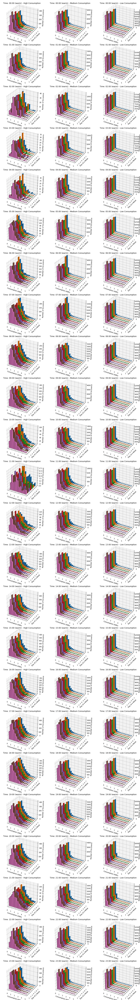

In [26]:
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
fig_all = plt.figure(figsize = (13,90))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        t.reset_index(inplace = True)
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        for k in range(n):
            ax = fig_all.add_subplot(24, 3, i * 3 + k + 1, projection = '3d')
            t2 = t[t.columns[np.insert(kmeans.labels_ == sorted_label[k][0], 0, True)]].copy() # select all data from the n-th cluster
            t2['DayofWeek'] = np.array(pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['GMT']).dt.dayofweek) # add day of a week column to dataframe
            for day in reversed(range(7)):
                t3 = t2[t2['DayofWeek'] == day] # select the data with a specific day of a week
                t3 = np.histogram(t3[t3.columns[1:-1]].values.flatten(), bins=13, range=(0,5))
                xpos = t3[1][:-1] 
                ypos = np.ones(13) * (day+1)
                num_elements = len(xpos)
                zpos = np.zeros(num_elements)
                dx = np.ones(13) * 0.2
                dy = np.ones(13) * 0.5
                # dz = t3[0] / ((kmeans.labels_ == sorted_label[k][0]).sum() * (t2['DayofWeek'] == day).sum())
                dz = t3[0]
                pl = ax.bar3d(xpos, ypos, zpos, dx, dy, dz, alpha = 0.5, zsort='max')
                pl._sort_zpos = i * 3 + k + 1
            ax.set_title('Time: 0' + str(i) + ':00' + ' (warm) - ' + str(cons_type[k]))
            ax.set_xlabel('Consumption (kWh)')
            ax.set_ylabel('Day of a Week')
            ax.set_zlabel('Number of Occurence')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        t.reset_index(inplace = True)
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        for k in range(n):
            ax = fig_all.add_subplot(24, 3, i * 3 + k + 1, projection = '3d')
            t2 = t[t.columns[np.insert(kmeans.labels_ == sorted_label[k][0], 0, True)]].copy() # select all data from the n-th cluster
            t2['DayofWeek'] = np.array(pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['GMT']).dt.dayofweek) # add day of weeks column to dataframe
            for day in reversed(range(7)):
                t3 = t2[t2['DayofWeek'] == day] # select the data with a specific day of a week
                t3 = np.histogram(t3[t3.columns[1:-1]].values.flatten(), bins=13, range=(0,5))
                xpos = t3[1][:-1] 
                ypos = np.ones(13) * (day+1)
                num_elements = len(xpos)
                zpos = np.zeros(num_elements)
                dx = np.ones(13) * 0.2
                dy = np.ones(13) * 0.5
                # dz = t3[0] / ((kmeans.labels_ == sorted_label[k][0]).sum() * (t2['DayofWeek'] == day).sum())
                dz = t3[0]
                pl = ax.bar3d(xpos, ypos, zpos, dx, dy, dz, alpha = 0.5, zsort='max')
                pl._sort_zpos = i * 3 + k + 1
            ax.set_title('Time: ' + str(i) + ':00' + ' (warm) - ' + str(cons_type[k]))
            ax.set_xlabel('Consumption (kWh)')
            ax.set_ylabel('Day of a Week')
            ax.set_zlabel('Number of Occurence')
plt.tight_layout()

Plot the three groups generated by PCA and k-mean clustering, in a space with 3 dimensions, temperature, day of week and consumption, and see if there is any obvious pattern.

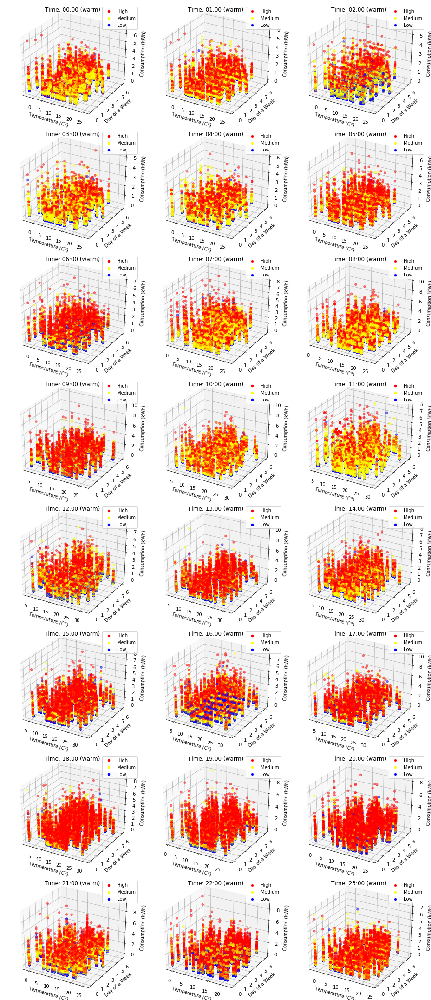

In [27]:
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
cons_type = ['High', 'Medium', 'Low']
color_type = ['red', 'yellow', 'blue']
fig_all = plt.figure(figsize = (13,30))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        t.reset_index(inplace = True)
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        ax = fig_all.add_subplot(8, 3, i + 1, projection = '3d')
        for k in range(n):
            t2 = t[t.columns[np.insert(kmeans.labels_ == sorted_label[k][0], 0, True)]].copy() # select all data from the n-th cluster
            t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['TempC'].values) # add temperature column to dataframe
            t2['DayofWeek'] = np.array(pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]['GMT']).dt.dayofweek) # add day of a week column to dataframe
            ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[1]], color = color_type[k], label = cons_type[k])
            for j in range(2, 1 + sorted_label[k][1]):
                ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[j]], color = color_type[k], alpha = 0.5)
                ax.legend()
        ax.set_title('Time: 0' + str(i) + ':00' + ' (warm)')
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Day of a Week')
        ax.set_zlabel('Consumption (kWh)')
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        t = x.fillna(x.mean()) # data used for analyzing consumption distribution
        x = t.transpose() # data for the specific hour, and filtering out null value
        t.reset_index(inplace = True)
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n).fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        for k in range(n):
            cluster_dict[k] = (kmeans.labels_ == k).sum() # store the labels and the number of data in a dict
        sorted_label = sorted(cluster_dict.items(), key=lambda kv: kv[1])
        ax = fig_all.add_subplot(8, 3, i + 1, projection = '3d')
        for k in range(n):
            t2 = t[t.columns[np.insert(kmeans.labels_ == sorted_label[k][0], 0, True)]].copy() # select all data from the n-th cluster
            t2['TempC'] = np.round(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['TempC'].values) # add temperature column to dataframe
            t2['DayofWeek'] = np.array(pd.to_datetime(df_wea1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]['GMT']).dt.dayofweek) # add day of a week column to dataframe
            ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[1]], color = color_type[k], label = cons_type[k])
            for j in range(2, 1 + sorted_label[k][1]):
                ax.scatter(t2[t2.columns[-2]], t2[t2.columns[-1]], t2[t2.columns[j]], color = color_type[k], alpha = 0.5)
                ax.legend()
        ax.set_title('Time: ' + str(i) + ':00' + ' (warm)')
        ax.set_xlabel(r'Temperature (C$^o$)')
        ax.set_ylabel('Day of a Week')
        ax.set_zlabel('Consumption (kWh)')
plt.tight_layout()

Let us deal with the classes of households. Each household should have a label vector of 24 hours.

In [31]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
n_house = 1025 # total household numbers
houseLabel = [] # store the 24hour group labels for each hoursehold
for i in range(1025):
    houseLabel.append('')
houseLabel = np.array(houseLabel)
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
fig_all = plt.figure(figsize = (13,90))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and fill in null value with mean
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
# We obtain the house Label shown below
# print(houseLabel)

# Group the house based on their 24 hour labels
houseLableDf = pd.DataFrame()
houseLableDf['House'] = df_tou1h_nf_warm.columns[1:]
houseLableDf['Label'] = houseLabel
houseGroupDf = houseLableDf.groupby('Label').size().reset_index(name='counts')
houseGroupDf = houseGroupDf.sort_values(by=['counts'], ascending=False)
houseGroupDf

,Label,counts
153,011101211001000000001111,314
381,120010002110221121222000,18
162,011101211001000001001111,9
43,011100211001000000001111,8
498,121101211001000000001110,6
156,011101211001000000021111,6
127,011101202001000000001111,5
173,011101211001000021001111,5
170,011101211001000020001111,5
23,011100002110221121222111,4


<Figure size 936x6480 with 0 Axes>

Note that the generated labels for the first 3 groups may change a bit each time, this is because some group of points which are very close to each other also have equal distance two both cluster centers, which leads to different label names. However, this won't affect the group property, we will show we run it for 100 times, and average 24 hour load curve of every time will be ploted. And you will see, the average load curve almost doesn't change. So label names wouldn't be an important concern here, we more care about the property of groups themselves. In addition, from the above result we can see the first 4 groups each has at least around 10 household in it. Next what we want to do is to plot the load property of each group, and see how does there average 24 hour load look like.

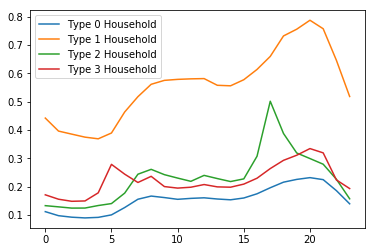

In [32]:
for i in range(4):
    load = []
    for j in range(24):
        if j <= 9:
            x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
        else:
            x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
    plt.plot(load, label = 'Type ' + str(i) + ' Household')
plt.legend()
plt.show()

See if the shape is sensitive to initialization, run it again:

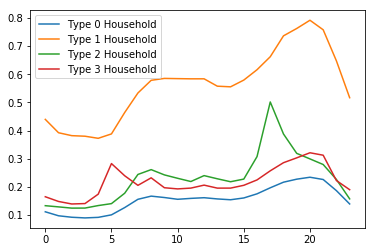

In [30]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
n_house = 1025 # total household numbers
houseLabel = [] # store the 24hour group labels for each hoursehold
for i in range(1025):
    houseLabel.append('')
houseLabel = np.array(houseLabel)
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and fill in null value with mean
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
# We obtain the house Label shown below
# print(houseLabel)

# Group the house based on their 24 hour labels
houseLableDf = pd.DataFrame()
houseLableDf['House'] = df_tou1h_nf_warm.columns[1:]
houseLableDf['Label'] = houseLabel
houseGroupDf = houseLableDf.groupby('Label').size().reset_index(name='counts')
houseGroupDf = houseGroupDf.sort_values(by=['counts'], ascending=False)

for i in range(4):
    load = []
    for j in range(24):
        if j <= 9:
            x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
        else:
            x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
    plt.plot(load, label = 'Type ' + str(i) + ' Household')
plt.legend()
plt.show()

Some observations and thoughts of the above daily load curves:

1) the type 0 household with the most amount of households has a relatively smooth and low consumption during a day, they consume the most amount of energy around 20:00, and consume least at 02:00-05:00.

2) type 1 household is high energy consumption households, besides of all the consumption is around 4 times the consumption of type 0 group, they have a relatively similar trend of energy usage pattern peak at 20:00 and valley at 02:00-05:00

3) type 2 household has a special usage pattern where their peak happens at 17:00 (maybe they come back home earlier), other parts about the same.

4) type 3 household also has a special usage pattern, where their peak happens at 05:00 (maybe they work in the morning, at home with some works that consumes a lot of energy, maybe breakfast, maybe heating at every morning?) and 20:00

## 3. Multiple Regression

Multiple Regression is to predict the consumption of the group in event (pricing change) time periods, so that we can analyze the price responsivness later.

It is clear that the temperature and days of a weeks are kinda correlated with the the first 3 PCA coefficients, we are using them as the features to do multiple regression (for each hour, temperature and days of week do regression).

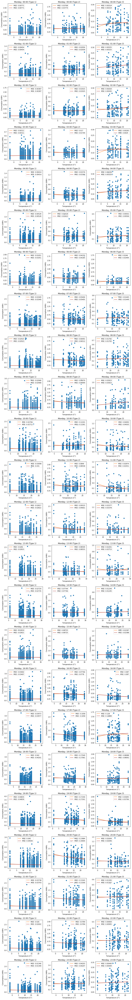

In [33]:
# Monday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 0 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for Monday
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for Monday
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

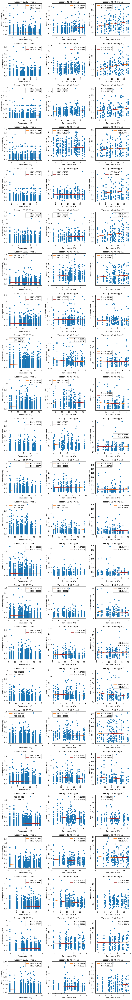

In [34]:
# Tuesday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 1 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for Tuesday
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for Tuesday
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

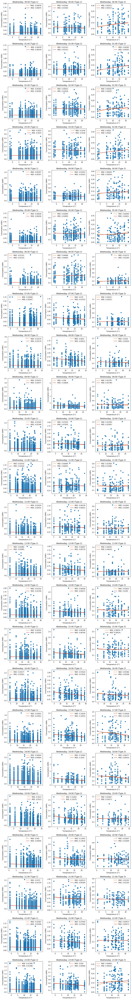

In [35]:
# Wednesday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 2 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

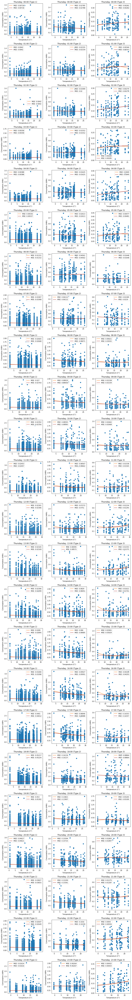

In [36]:
# Thursday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 3 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

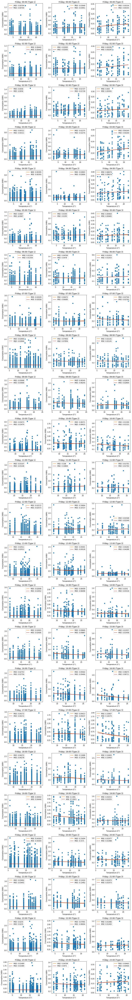

In [37]:
# Friday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 4 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

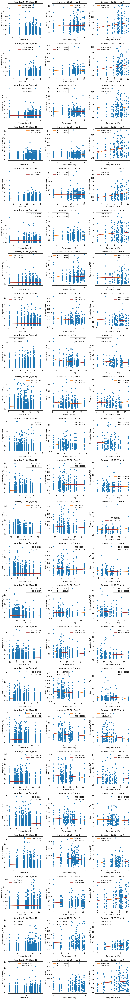

In [38]:
# Saturday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 5 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

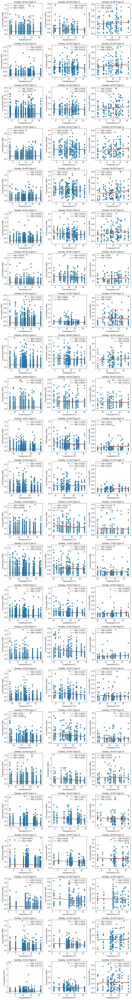

In [39]:
# Sunday hourly regressions in warm seasons
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
day_of_week = 6 # 0 is Monday, 6 is Sunday
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        if i <= 9:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': 0' + str(i) + ':00 (Type ' + str(g+1) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
        else:
            z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
            y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
            y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for the corresponding day of a week
            y.set_index('GMT', inplace = True)
            y = y.fillna(y.mean()).values
            y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
            
            x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
            x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
            xp = np.linspace(min(x), max(x), 50) # polynomial regression
            z = np.polyfit(x, y, 2)
            p = np.poly1d(z)
            ax_Ntou[-1].plot(xp, p(xp), color = 'xkcd:orange', label = 'MSE: ' + str(round(mean_squared_error(y, p(x)), 5)))
            x = x.reshape(-1, 1)
            y = y.reshape(-1, 1)
            lm.fit(x, y)
            ax_Ntou[-1].plot(x, lm.predict(x), color = 'brown', label = 'MSE: ' + str(round(mean_squared_error(y, lm.predict(x)), 5)))
            ax_Ntou[-1].scatter(x, y)
            ax_Ntou[-1].set_title(weeks[day_of_week] + ': ' + str(i) + ':00 (Type ' + str(g+1) + ')')
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            ax_Ntou[-1].legend()
plt.tight_layout()

## 4. Groups' Price Responsiveness - K-mean based

The way we analyze the group price responsiveness has three steps:

1) for each hosehold group, build a new dataframe, the first column is GMT, the next columns are user ids in the group, the next column is temperature, then the price, day of a week, hour of a day, then the predicted consumption, and last the price responsiveness

2) build a function that can generate predicted consumption based on the day of a week, temp, hour to choose the coefficients and then make a prediction.

3) plot the properties based on from the smallest unit (day of week, hour, temp) to (day of week, hour), (day of week, temp), (hour, temp), (day of week), (hour), (temp) so we will have very comprehensive price responsiveness of three different groups


In [7]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
n_house = 1025 # total household numbers
houseLabel = [] # store the 24hour group labels for each hoursehold
for i in range(1025):
    houseLabel.append('')
houseLabel = np.array(houseLabel)
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
fig_all = plt.figure(figsize = (13,90))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and fill in null value with mean
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
    else:
        x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
# We obtain the house Label shown below
# print(houseLabel)

# Group the house based on their 24 hour labels
houseLableDf = pd.DataFrame()
houseLableDf['House'] = df_tou1h_nf_warm.columns[1:]
houseLableDf['Label'] = houseLabel
houseGroupDf = houseLableDf.groupby('Label').size().reset_index(name='counts')
houseGroupDf = houseGroupDf.sort_values(by=['counts'], ascending=False)
houseGroupDf

,Label,counts
129,000001200000001200012000,314
508,121120021222120011200122,19
140,000001200000001201012000,9
36,000000200000001200012000,8
399,120001200000001200012002,6
147,000001200000001210012000,6
126,000001200000001200002000,6
231,000001221000001200012000,5
149,000001200000001211012000,5
137,000001200000001200212000,4


<Figure size 936x6480 with 0 Axes>

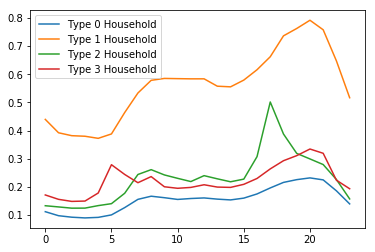

In [8]:
for i in range(4):
    load = []
    for j in range(24):
        if j <= 9:
            x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
        else:
            x = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
    plt.plot(load, label = 'Type ' + str(i) + ' Household')
plt.legend()
plt.show()

In [13]:
# Store warm season houshold labels
house_list_type0 = list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[0]].House)
house_list_type1 = list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[1]].House)
house_list_type2 = list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[2]].House)

In [57]:
# Type 0 household
# build a new dataframe with columns: GMT, user ids in the group
df_type0 = df_tou1h_event_warm[['GMT'] + list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[0]].House)]
df_type0 = pd.merge(df_type0, df_wea1h_event_warm, on = 'GMT') # add weather
df_type0 = pd.merge(df_type0, df_tariff_1h_event_warm, on = 'GMT') # add price
df_type0['Day of week'] = pd.to_datetime(df_type0.GMT).dt.dayofweek # add day of week
df_type0['Hour of day'] = pd.to_datetime(df_type0.GMT).dt.hour # add hour of day
df_type0['Household type'] = 0

# Type 1 household
# build a new dataframe with columns: GMT, user ids in the group
df_type1 = df_tou1h_event_warm[['GMT'] + list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[1]].House)]
df_type1 = pd.merge(df_type1, df_wea1h_event_warm, on = 'GMT') # add weather
df_type1 = pd.merge(df_type1, df_tariff_1h_event_warm, on = 'GMT') # add price
df_type1['Day of week'] = pd.to_datetime(df_type1.GMT).dt.dayofweek # add day of week
df_type1['Hour of day'] = pd.to_datetime(df_type1.GMT).dt.hour # add hour of day
df_type1['Household type'] = 1

# Type 2 household
# build a new dataframe with columns: GMT, user ids in the group
df_type2 = df_tou1h_event_warm[['GMT'] + list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[2]].House)]
df_type2 = pd.merge(df_type2, df_wea1h_event_warm, on = 'GMT') # add weather
df_type2 = pd.merge(df_type2, df_tariff_1h_event_warm, on = 'GMT') # add price
df_type2['Day of week'] = pd.to_datetime(df_type2.GMT).dt.dayofweek # add day of week
df_type2['Hour of day'] = pd.to_datetime(df_type2.GMT).dt.hour # add hour of day
df_type2['Household type'] = 2

With the household type and feature data ready, we need to build functions that can predict the consumptions during these time periods. Since we are considering group properties, the above users are all in the first group, for each time period, we only have one consumption predicted for the whole group, but since the regression coefficients depend on day of week, temperature and hour of day, so it should be quite different for different time.

In [58]:
def predict(dfRegression, dayOfWeek, hour, temperature):
    '''
    Predict the consumption duruing event time based on 
    the regression, day of week, hour of a day and temperature
    '''
    weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
    output = dfRegression[weeks[dayOfWeek]].iloc[hour](temperature)
    return output

In [59]:
# store the regression coefficients
import seaborn as sns
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
df_regression_0 = {} # store the regression coefficients
df_regression_1 = {}
df_regression_2 = {}
# df_regression_3 = {}
lm = LinearRegression()
for g in range(3): # doing this for three groups
    for day_of_week in range(7):
        coef_temp = []
        for i in range(24):
            if i <= 9:
                z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains('0' + str(i) + ':00:00')]
                y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
                y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for Monday
                y.set_index('GMT', inplace = True)
                y = y.fillna(y.mean()).values
                y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable
                x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains('0' + str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
                x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
                z = np.polyfit(x, y, 2)
                p = np.poly1d(z)
                coef_temp.append(p)
            else:
                z = df_tou1h_nf_warm[df_tou1h_nf_warm.GMT.str.contains(str(i) + ':00:00')]
                y_temp = z[['GMT'] + list(houseLableDf[(houseLableDf.Label == houseGroupDf.Label.iloc[g]) ].House)]
                y = y_temp[pd.to_datetime(z.GMT).dt.dayofweek == day_of_week] # find the users' data for Monday
                y.set_index('GMT', inplace = True)
                y = y.fillna(y.mean()).values
                y = np.reshape(y, y.shape[0] * y.shape[1], order = 'F') # reconstruct the y variable

                x = df_wea1h_nf_warm.TempC[(df_wea1h.GMT.str.contains(str(i) + ':00:00')) & (pd.to_datetime(z.GMT).dt.dayofweek == day_of_week)].values
                x = np.tile(x, reps = sum(houseLableDf.Label == houseGroupDf.Label.iloc[g])) # reconstruct the x variable
                z = np.polyfit(x, y, 2)
                p = np.poly1d(z)
                coef_temp.append(p)
        if g == 0:
            df_regression_0[weeks[day_of_week]] = coef_temp
        elif g == 1:
            df_regression_1[weeks[day_of_week]] = coef_temp
        else:
            df_regression_2[weeks[day_of_week]] = coef_temp
df_regression_0 = pd.DataFrame(df_regression_0) # type 0 regression coefficient
df_regression_1 = pd.DataFrame(df_regression_1) # type 1 
df_regression_2 = pd.DataFrame(df_regression_2) # type 2 

In [49]:
# type 0 event time consumption prediction
pred_result = []
for i in range(df_type0.shape[0]):
    pred_result.append(predict(df_regression_0, df_type0['Day of week'].iloc[i], df_type0['Hour of day'].iloc[i], df_type0['TempC'].iloc[i]))
df_type0['Predicted consumption'] = pred_result
# price responsiveness elementwise
df_type0_res = df_type0.copy()
df_type0_res.iloc[:,1:houseGroupDf.counts.iloc[0] + 1] = df_type0.iloc[:,1:houseGroupDf.counts.iloc[0] + 1].sub(df_type0['Predicted consumption'], axis = 0)

# type 1 event time consumption prediction
pred_result = []
for i in range(df_type1.shape[0]):
    pred_result.append(predict(df_regression_1, df_type1['Day of week'].iloc[i], df_type1['Hour of day'].iloc[i], df_type1['TempC'].iloc[i]))
df_type1['Predicted consumption'] = pred_result

# price responsiveness elementwise
df_type1_res = df_type1.copy()
df_type1_res.iloc[:,1:houseGroupDf.counts.iloc[1] + 1] = df_type1.iloc[:,1:houseGroupDf.counts.iloc[1] + 1].sub(df_type1['Predicted consumption'], axis = 0)

# type 2 event time consumption prediction
pred_result = []
for i in range(df_type2.shape[0]):
    pred_result.append(predict(df_regression_2, df_type2['Day of week'].iloc[i], df_type2['Hour of day'].iloc[i], df_type2['TempC'].iloc[i]))
df_type2['Predicted consumption'] = pred_result

# price responsiveness elementwise
df_type2_res = df_type2.copy()
df_type2_res.iloc[:,1:houseGroupDf.counts.iloc[2] + 1] = df_type2.iloc[:,1:houseGroupDf.counts.iloc[2] + 1].sub(df_type2['Predicted consumption'], axis = 0)

To visualize the price responsiveness, we need to reformat the data and melt them to a long dataframe, and all the user ID columns will be extracted to form a individual dataframe with adding household group label and we concatenate all of them in a long dataframe.

In [50]:
houseGroupDf.counts.iloc[0]

318

In [59]:
df_type0_res.head()

,GMT,D0001,D0008,D0010,D0012,D0013,D0016,D0018,D0021,D0024,...,D1023,D1024,TempC,TempF,Price,Event_tags,Day of week,Hour of day,Household type,Predicted consumption
0,2013-04-05 19:00:00,0.059165,0.309165,-0.210835,0.185165,0.742165,0.214165,-0.165835,-0.176835,0.022165,...,0.004165,0.250165,2.333333,36.333333,0.672,H3,4,19,0,0.210835
1,2013-04-05 20:00:00,0.060997,0.144997,-0.245003,-0.055003,0.108997,0.189997,-0.205003,-0.207003,-0.004003,...,-0.046003,-0.031003,0.666667,33.666667,0.672,H3,4,20,0,0.245003
2,2013-04-05 21:00:00,0.039187,NaN,-0.215813,-0.073813,0.152187,0.042187,-0.163813,-0.176813,0.035187,...,-0.080813,-0.037813,-1.000000,31.000000,0.672,H3,4,21,0,0.216813
3,2013-04-08 10:00:00,0.056350,-0.039650,-0.171650,0.133350,-0.028650,-0.100650,-0.072650,-0.137650,-0.116650,...,-0.073650,-0.051650,8.000000,46.333333,0.672,H3,0,10,0,0.171650
4,2013-04-08 11:00:00,-0.036222,-0.076222,-0.174222,-0.023222,0.079778,-0.103222,-0.083222,-0.042222,-0.113222,...,-0.134222,-0.079222,9.000000,47.666667,0.672,H3,0,11,0,0.174222


In [52]:
df_type0_res

,GMT,D0001,D0008,D0010,D0012,D0013,D0016,D0018,D0021,D0024,...,D1023,D1024,TempC,TempF,Price,Event_tags,Day of week,Hour of day,Household type,Predicted consumption
0,2013-04-05 19:00:00,0.059165,0.309165,-0.210835,0.185165,0.742165,0.214165,-0.165835,-0.176835,0.022165,...,0.004165,0.250165,2.333333,36.333333,0.6720,H3,4,19,0,0.210835
1,2013-04-05 20:00:00,0.060997,0.144997,-0.245003,-0.055003,0.108997,0.189997,-0.205003,-0.207003,-0.004003,...,-0.046003,-0.031003,0.666667,33.666667,0.6720,H3,4,20,0,0.245003
2,2013-04-05 21:00:00,0.039187,NaN,-0.215813,-0.073813,0.152187,0.042187,-0.163813,-0.176813,0.035187,...,-0.080813,-0.037813,-1.000000,31.000000,0.6720,H3,4,21,0,0.216813
3,2013-04-08 10:00:00,0.056350,-0.039650,-0.171650,0.133350,-0.028650,-0.100650,-0.072650,-0.137650,-0.116650,...,-0.073650,-0.051650,8.000000,46.333333,0.6720,H3,0,10,0,0.171650
4,2013-04-08 11:00:00,-0.036222,-0.076222,-0.174222,-0.023222,0.079778,-0.103222,-0.083222,-0.042222,-0.113222,...,-0.134222,-0.079222,9.000000,47.666667,0.6720,H3,0,11,0,0.174222
5,2013-04-08 12:00:00,-0.021420,-0.066420,-0.183420,0.685580,-0.053420,-0.113420,-0.125420,-0.151420,-0.119420,...,-0.137420,-0.099420,10.000000,49.000000,0.6720,H3,0,12,0,0.184420
6,2013-04-11 01:00:00,-0.020985,0.011015,-0.091985,0.046015,-0.003985,-0.018985,-0.040985,-0.092985,0.056015,...,0.023015,0.045015,4.333333,39.333333,0.6720,H3,3,1,0,0.092985
7,2013-04-11 02:00:00,0.029225,0.038225,-0.089775,0.045225,0.003225,-0.017775,-0.006775,-0.089775,0.037225,...,-0.041775,0.017225,4.666667,39.666667,0.6720,H3,3,2,0,0.089775
8,2013-04-11 03:00:00,-0.027269,0.040731,-0.088269,0.022731,0.015731,-0.016269,-0.042269,-0.088269,-0.016269,...,-0.061269,0.012731,5.000000,40.000000,0.6720,H3,3,3,0,0.088269
9,2013-04-13 16:00:00,-0.160185,-0.110185,-0.202185,0.263815,0.047815,-0.125185,-0.164185,-0.187185,-0.127185,...,-0.185185,-0.068185,9.333333,48.666667,0.6720,H6,5,16,0,0.202185


In [60]:
# select each user ID and form a seperate dataframe
# first change all the user ID to "Consumption"
new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[0]):
    new_col.append('Consumption')
new_col = new_col + list(df_type0_res.columns)[-8:] # the new column names
df_type0_res.columns = new_col
df_all_res_long = pd.DataFrame()
for i in range(1, houseGroupDf.counts.iloc[0] + 1):
    df_all_res_long = df_all_res_long.append(df_type0_res.iloc[:,[0,i,-8,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[1]): # for renaming the second type
    new_col.append('Consumption')
new_col = new_col + list(df_type1_res.columns)[-8:] # the new column names
df_type1_res.columns = new_col
for i in range(1, houseGroupDf.counts.iloc[1] + 1):
    df_all_res_long = df_all_res_long.append(df_type1_res.iloc[:,[0,i,-8,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[2]): # for renaming the third type
    new_col.append('Consumption')
new_col = new_col + list(df_type2_res.columns)[-8:] # the new column names
df_type2_res.columns = new_col
for i in range(1, houseGroupDf.counts.iloc[2] + 1):
    df_all_res_long = df_all_res_long.append(df_type2_res.iloc[:,[0,i,-8,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

# for clearer visulization, round the temperatures
df_all_res_long['TempC'] = df_all_res_long.TempC.round(0)
df_all_res_long['TempF'] = df_all_res_long.TempF.round(0)
df_all_res_long # ready for the price responsiveness analysis

,GMT,Consumption,TempC,TempF,Price,Event_tags,Day of week,Hour of day,Household type,Predicted consumption
0,2013-04-05 19:00:00,0.059165,2.0,36.0,0.6720,H3,4,19,0,0.210835
1,2013-04-05 20:00:00,0.060997,1.0,34.0,0.6720,H3,4,20,0,0.245003
2,2013-04-05 21:00:00,0.039187,-1.0,31.0,0.6720,H3,4,21,0,0.216813
3,2013-04-08 10:00:00,0.056350,8.0,46.0,0.6720,H3,0,10,0,0.171650
4,2013-04-08 11:00:00,-0.036222,9.0,48.0,0.6720,H3,0,11,0,0.174222
5,2013-04-08 12:00:00,-0.021420,10.0,49.0,0.6720,H3,0,12,0,0.184420
6,2013-04-11 01:00:00,-0.020985,4.0,39.0,0.6720,H3,3,1,0,0.092985
7,2013-04-11 02:00:00,0.029225,5.0,40.0,0.6720,H3,3,2,0,0.089775
8,2013-04-11 03:00:00,-0.027269,5.0,40.0,0.6720,H3,3,3,0,0.088269
9,2013-04-13 16:00:00,-0.160185,9.0,49.0,0.6720,H6,5,16,0,0.202185


Then plot the properties based on from the smallest unit (day of week, hour, temp) to (day of week, hour), (day of week, temp), (hour, temp), (day of week), (hour), (temp) for different prices (high and low) so we will have very comprehensive price responsiveness of three different groups

a) Day of week - hour - temperature : prices

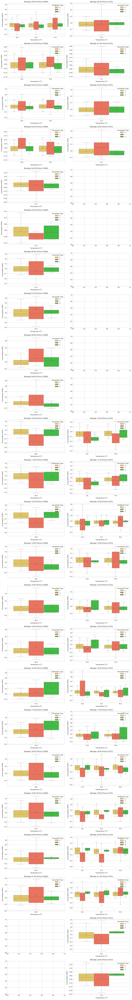

In [61]:
# Monday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 0 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)    
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5) 
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

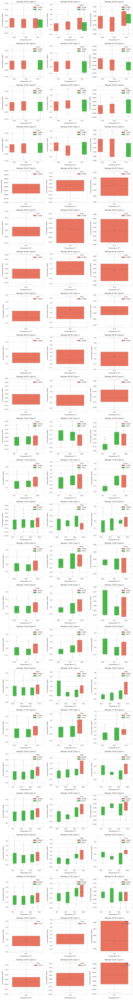

In [62]:
# Price comparison version
# Monday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 0 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)    
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5) 
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

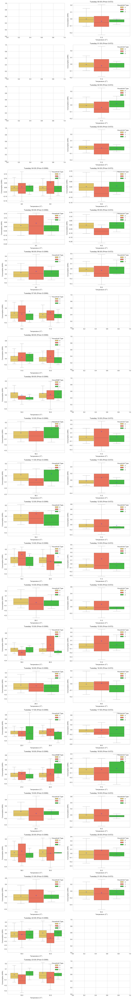

In [63]:
# Tuesday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 1 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)    
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

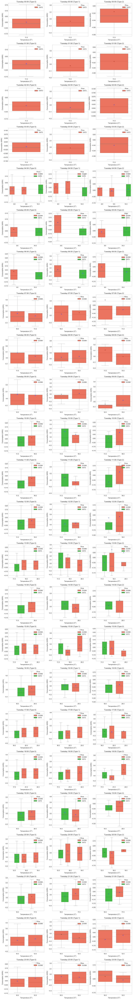

In [64]:
# Price comparison
# Tuesday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 1 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)    
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

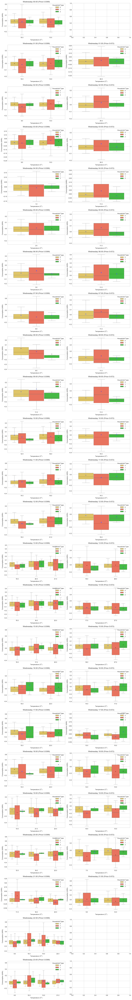

In [65]:
# Wednesday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 2 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)  
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')       
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

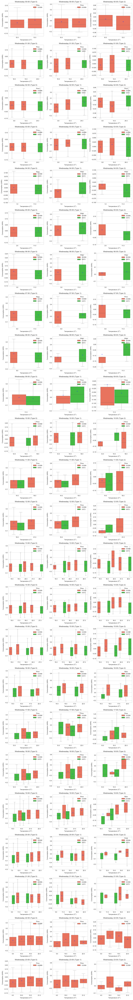

In [66]:
# price comparison
# Wednesday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 2 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)  
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')       
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

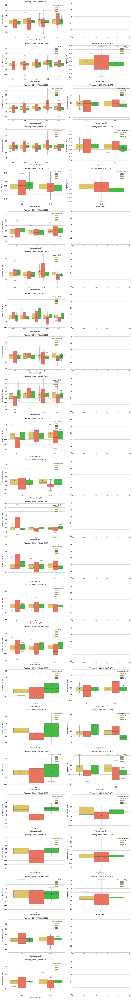

In [67]:
# Thursday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 3 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)        
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')   
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

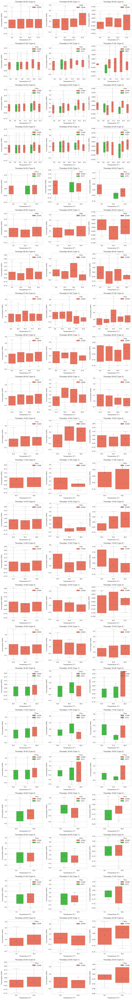

In [68]:
# price comparison
# Thursday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 3 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)        
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')   
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

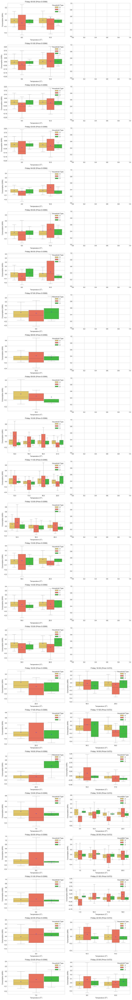

In [69]:
# Friday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 4 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers=False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')      
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers=False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

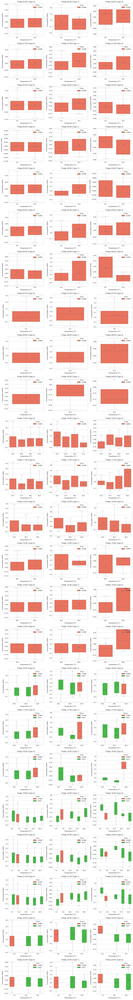

In [70]:
# price comparison
# Friday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 4 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers=False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')      
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers=False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

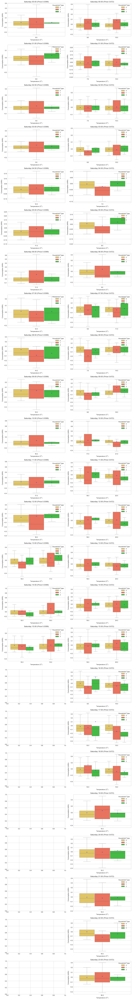

In [71]:
# Saturday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 5 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')      
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

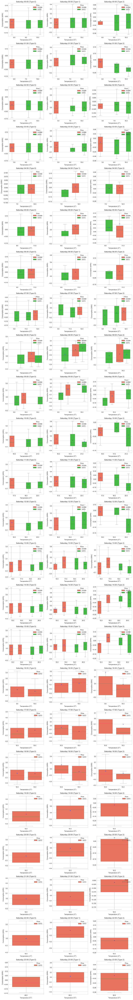

In [72]:
# price comparison
# Saturday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 5 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')      
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

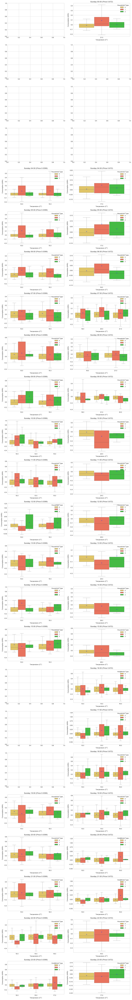

In [73]:
# Sunday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 6 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Price'] == prices[p])]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Price ' + str(prices[p]) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)    
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')       
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Price ' + str(prices[p]) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Household Type')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

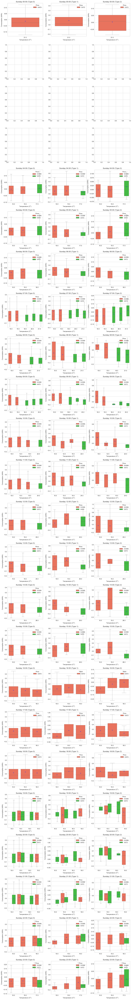

In [74]:
# price comparison
# Sunday hourly price responsiveness with different temperature and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
day_of_week = 6 # 0 is Monday, 6 is Sunday
df_day = df_all_res_long[df_all_res_long['Day of week'] == day_of_week]
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_day_hour = df_day[(df_day['Hour of day'] == i) & (df_day['Household type'] == g)]
        if df_day_hour.shape[0] >= 1:
            if i <= 9:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' 0' + str(i) + ':00 (Type ' + str(g) + ')' )
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)    
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')       
            else:
                sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
                ax_Ntou[-1].set_title(weeks[day_of_week] + ' ' + str(i) + ':00 (Type ' + str(g) + ')')
                ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
                ax_Ntou[-1].set_ylabel('Consumption (kWh)')
                l = ax_Ntou[-1].legend()
                l.set_title('Price')
                for i,artist in enumerate(ax_Ntou[-1].artists):
                    artist.set_linewidth(0.5)
                    # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                    # Loop over them here, and use the same colour as above
                    for j in range(i*6,i*6+6):
                        line = ax_Ntou[-1].lines[j]
                        line.set_linewidth(0.5)     
                ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

type2 may not be a good candidate for DR; type0 and type1 are good candidates but the program design must pay attention to the temperature impact on the demand responsiveness, we can expect with the same temperature, lower price would increase the consumption, higher price would decrease consumption, but this may not be true in different temperature situations. Conclusion: demand response plan must consider temperature impact, i.e., differentiated based on temperature situations instead of use a unified demand response plan for all temperatures.

b) Day of week - hour : prices

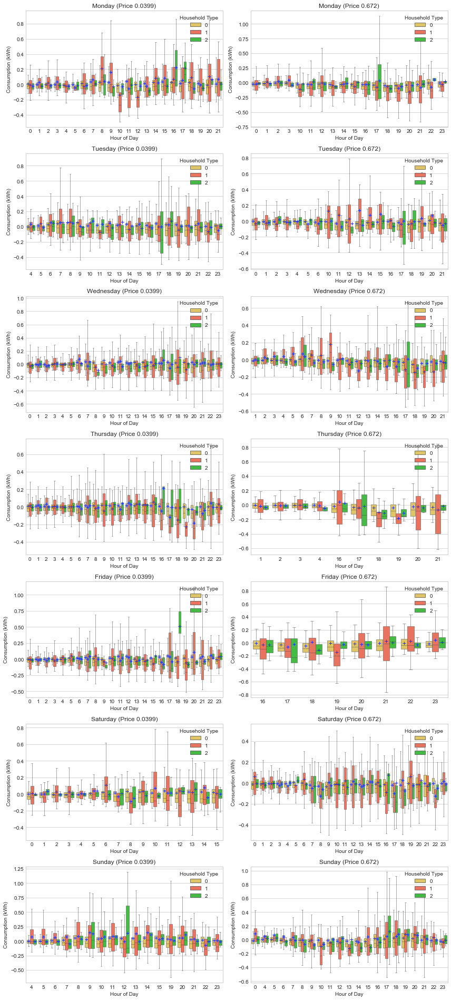

In [75]:
# hourly price responsiveness over days of week and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for p in range(2): # two price levels
    for day_of_week in range(7):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * day_of_week + (p + 1)))
        df_day = df_all_res_long[(df_all_res_long['Day of week'] == day_of_week) & (df_all_res_long['Price'] == prices[p])]
        if df_day.shape[0] >= 1:
            sns.boxplot(x="Hour of day", y="Consumption", hue="Household type", data=df_day, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
            ax_Ntou[-1].set_title(weeks[day_of_week]  + ' (Price ' + str(prices[p]) + ')' )
            ax_Ntou[-1].set_xlabel(r'Hour of Day')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            l = ax_Ntou[-1].legend()
            l.set_title('Household Type')
            for i,artist in enumerate(ax_Ntou[-1].artists):
                artist.set_linewidth(0.5)
                # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                # Loop over them here, and use the same colour as above
                for j in range(i*6,i*6+6):
                    line = ax_Ntou[-1].lines[j]
                    line.set_linewidth(0.5)    
            ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

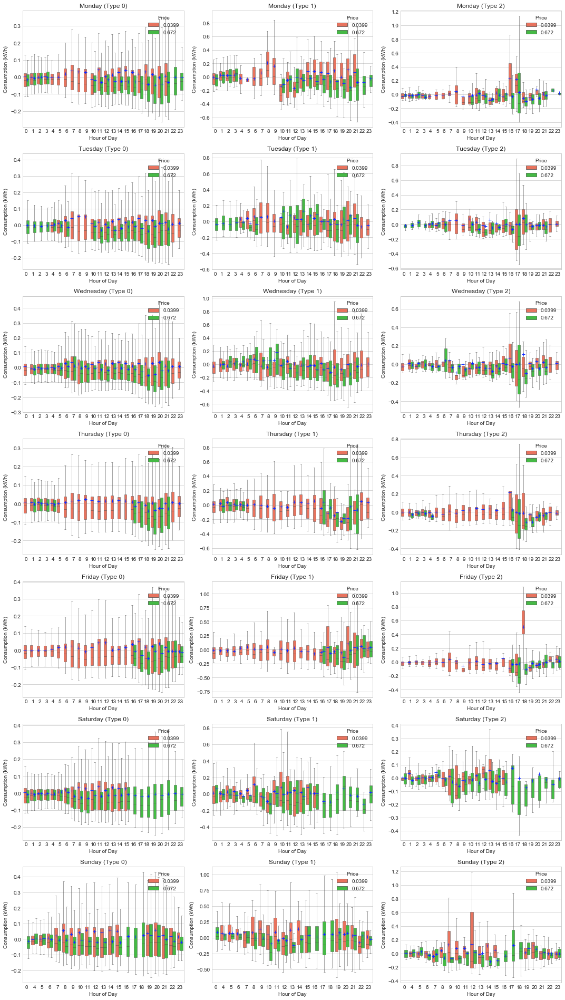

In [76]:
# price comparison
# hourly price responsiveness over days of week and prices
fig_all = plt.figure(figsize = (15,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for g in range(3): # three types
    for day_of_week in range(7):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * day_of_week + (g + 1)))
        df_day = df_all_res_long[(df_all_res_long['Day of week'] == day_of_week) & (df_all_res_long['Household type'] == g)]
        if df_day.shape[0] >= 1:
            sns.boxplot(x="Hour of day", y="Consumption", hue="Price", data=df_day, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
            ax_Ntou[-1].set_title(weeks[day_of_week]  + ' (Type ' + str(g) + ')' )
            ax_Ntou[-1].set_xlabel(r'Hour of Day')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            l = ax_Ntou[-1].legend()
            l.set_title('Price')
            for i,artist in enumerate(ax_Ntou[-1].artists):
                artist.set_linewidth(0.5)
                # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                # Loop over them here, and use the same colour as above
                for j in range(i*6,i*6+6):
                    line = ax_Ntou[-1].lines[j]
                    line.set_linewidth(0.5)    
            ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

Again, type 0 shows better price reponsiveness than type1 and 2.

c) Day of week - temperature : prices

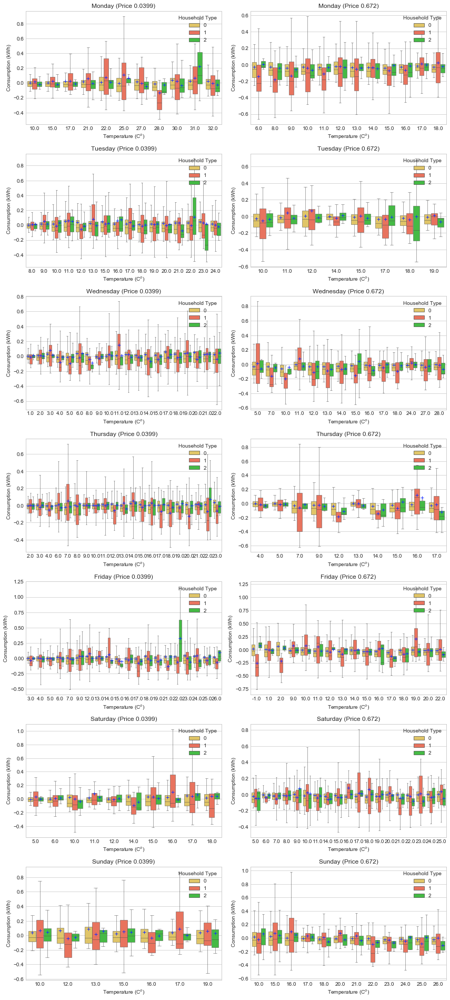

In [77]:
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for p in range(2): # two price levels
    for day_of_week in range(7):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * day_of_week + (p + 1)))
        df_day = df_all_res_long[(df_all_res_long['Day of week'] == day_of_week) & (df_all_res_long['Price'] == prices[p])]
        if df_day.shape[0] >= 1:
            sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_day, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
            ax_Ntou[-1].set_title(weeks[day_of_week]  + ' (Price ' + str(prices[p]) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            l = ax_Ntou[-1].legend()
            l.set_title('Household Type')
            for i,artist in enumerate(ax_Ntou[-1].artists):
                artist.set_linewidth(0.5)
                # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                # Loop over them here, and use the same colour as above
                for j in range(i*6,i*6+6):
                    line = ax_Ntou[-1].lines[j]
                    line.set_linewidth(0.5)    
            ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

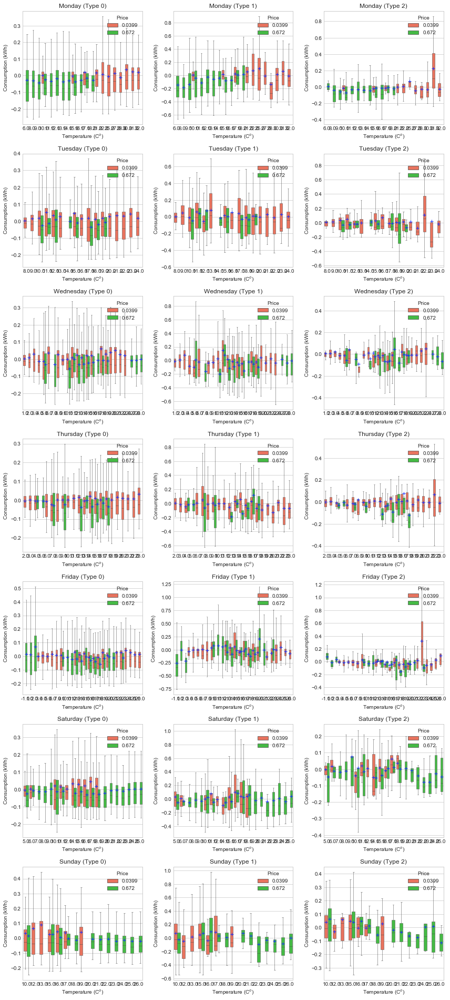

In [78]:
# price comparision
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
weeks = ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for g in range(3): # three types
    for day_of_week in range(7):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3 * day_of_week + (g + 1)))
        df_day = df_all_res_long[(df_all_res_long['Day of week'] == day_of_week) & (df_all_res_long['Household type'] == g)]
        if df_day.shape[0] >= 1:
            sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_day, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
            ax_Ntou[-1].set_title(weeks[day_of_week]  + ' (Type ' + str(g) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            l = ax_Ntou[-1].legend()
            l.set_title('Price')
            for i,artist in enumerate(ax_Ntou[-1].artists):
                artist.set_linewidth(0.5)
                # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                # Loop over them here, and use the same colour as above
                for j in range(i*6,i*6+6):
                    line = ax_Ntou[-1].lines[j]
                    line.set_linewidth(0.5)    
            ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

d) Hour of day - temperature : prices

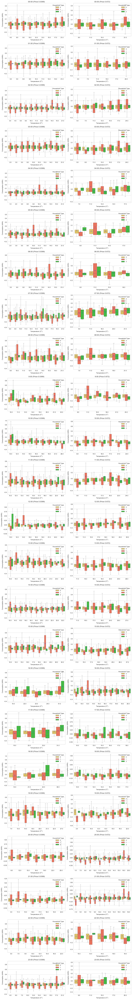

In [79]:
# hourly price responsiveness over temperatures and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for p in range(2): # two price levels
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 2, 2 * i + (p + 1)))
        df_hour = df_all_res_long[(df_all_res_long['Hour of day'] == i) & (df_all_res_long['Price'] == prices[p])]
#         min_consumption = df_hour['Consumption'].min()
#         max_consumption = df_hour['Consumption'].max()
        if df_hour.shape[0] >= 1:
            sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
            if i < 9:
                ax_Ntou[-1].set_title('0' + str(i) + ':00' + ' (Price ' + str(prices[p]) + ')' )
            else:
                ax_Ntou[-1].set_title(str(i) + ':00' + ' (Price ' + str(prices[p]) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            l = ax_Ntou[-1].legend()
            l.set_title('Household Type')
            for i,artist in enumerate(ax_Ntou[-1].artists):
                artist.set_linewidth(0.5)
                # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                # Loop over them here, and use the same colour as above
                for j in range(i*6,i*6+6):
                    line = ax_Ntou[-1].lines[j]
                    line.set_linewidth(0.5)    
            ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

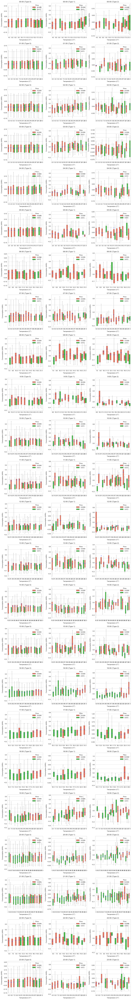

In [80]:
# price comparision
# hourly price responsiveness over temperatures and prices
fig_all = plt.figure(figsize = (12,90))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for g in range(3): # three types
    for i in range(24):
        ax_Ntou.append(fig_all.add_subplot(24, 3, 3* i + (g + 1)))
        df_hour = df_all_res_long[(df_all_res_long['Hour of day'] == i) & (df_all_res_long['Household type'] == g)]
#         min_consumption = df_hour['Consumption'].min()
#         max_consumption = df_hour['Consumption'].max()
        if df_hour.shape[0] >= 1:
            sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
            if i < 9:
                ax_Ntou[-1].set_title('0' + str(i) + ':00' + ' (Type ' + str(g) + ')' )
            else:
                ax_Ntou[-1].set_title(str(i) + ':00' + ' (Type ' + str(g) + ')' )
            ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
            ax_Ntou[-1].set_ylabel('Consumption (kWh)')
            l = ax_Ntou[-1].legend()
            l.set_title('Price')
            for i,artist in enumerate(ax_Ntou[-1].artists):
                artist.set_linewidth(0.5)
                # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
                # Loop over them here, and use the same colour as above
                for j in range(i*6,i*6+6):
                    line = ax_Ntou[-1].lines[j]
                    line.set_linewidth(0.5)    
            ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

e) Day of week: prices

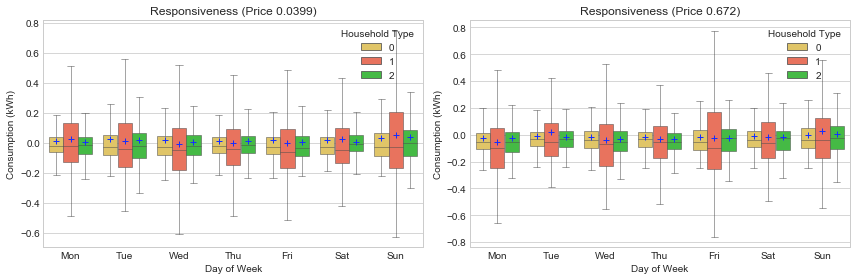

In [83]:
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,4))
ax_Ntou = [] # store subplot objects
weeks = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for p in range(2): # two price levels
    ax_Ntou.append(fig_all.add_subplot(1, 2, (p + 1)))
    df_day = df_all_res_long[df_all_res_long['Price'] == prices[p]]
    if df_day.shape[0] >= 1:
        sns.boxplot(x="Day of week", y="Consumption", hue="Household type", data=df_day, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
        ax_Ntou[-1].set_title('Responsiveness'  + ' (Price ' + str(prices[p]) + ')' )
        ax_Ntou[-1].set_xlabel(r'Day of Week')
        ax_Ntou[-1].set_xticklabels(weeks)
        ax_Ntou[-1].set_ylabel('Consumption (kWh)')
        l = ax_Ntou[-1].legend()
        l.set_title('Household Type')
        for i,artist in enumerate(ax_Ntou[-1].artists):
            artist.set_linewidth(0.5)
            # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
            # Loop over them here, and use the same colour as above
            for j in range(i*6,i*6+6):
                line = ax_Ntou[-1].lines[j]
                line.set_linewidth(0.5)
        ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

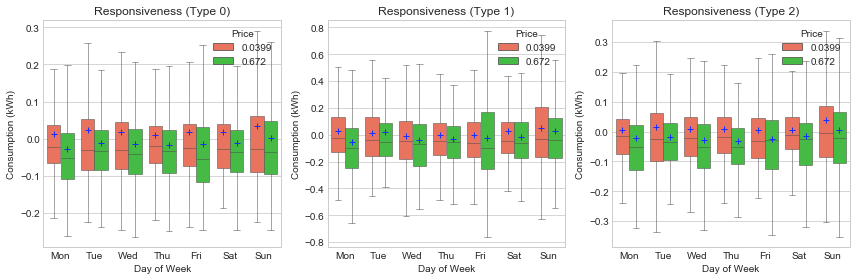

In [84]:
# price comparison
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,4))
ax_Ntou = [] # store subplot objects
weeks = ['Mon', 'Tue', 'Wed', 'Thu', 'Fri', 'Sat', 'Sun']
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for g in range(3): # three types
    ax_Ntou.append(fig_all.add_subplot(1, 3, (g + 1)))
    df_day = df_all_res_long[df_all_res_long['Household type'] == g]
    if df_day.shape[0] >= 1:
        sns.boxplot(x="Day of week", y="Consumption", hue="Price", data=df_day, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
        ax_Ntou[-1].set_title('Responsiveness'  + ' (Type ' + str(g) + ')' )
        ax_Ntou[-1].set_xlabel(r'Day of Week')
        ax_Ntou[-1].set_xticklabels(weeks)
        ax_Ntou[-1].set_ylabel('Consumption (kWh)')
        l = ax_Ntou[-1].legend()
        l.set_title('Price')
        for i,artist in enumerate(ax_Ntou[-1].artists):
            artist.set_linewidth(0.5)
            # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
            # Loop over them here, and use the same colour as above
            for j in range(i*6,i*6+6):
                line = ax_Ntou[-1].lines[j]
                line.set_linewidth(0.5)
        ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

Average consumption kinda increases along days of weeks (from Monday to Sunday)

f) Hour of day: prices

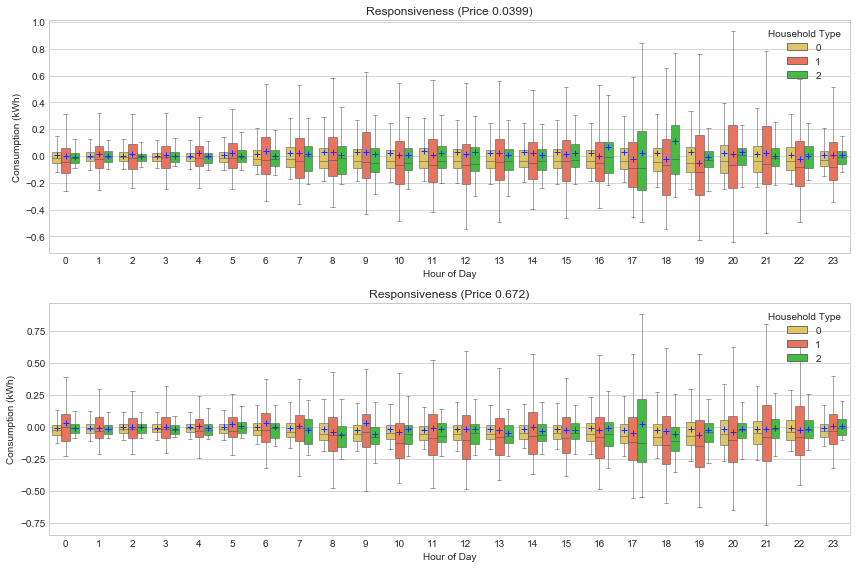

In [85]:
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,8))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for p in range(2): # two price levels
    ax_Ntou.append(fig_all.add_subplot(2, 1, (p + 1)))
    df_hour = df_all_res_long[df_all_res_long['Price'] == prices[p]]
    if df_hour.shape[0] >= 1:
        sns.boxplot(x="Hour of day", y="Consumption", hue="Household type", data=df_hour, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
        ax_Ntou[-1].set_title('Responsiveness'  + ' (Price ' + str(prices[p]) + ')' )
        ax_Ntou[-1].set_xlabel(r'Hour of Day')
        ax_Ntou[-1].set_ylabel('Consumption (kWh)')
        l = ax_Ntou[-1].legend()
#         ax_Ntou[-1].yaxis.grid(True)
#         ax_Ntou[-1].xaxis.grid(True)
        l.set_title('Household Type')
        for i,artist in enumerate(ax_Ntou[-1].artists):
            artist.set_linewidth(0.5)
            # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
            # Loop over them here, and use the same colour as above
            for j in range(i*6,i*6+6):
                line = ax_Ntou[-1].lines[j]
                line.set_linewidth(0.5) 
        ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

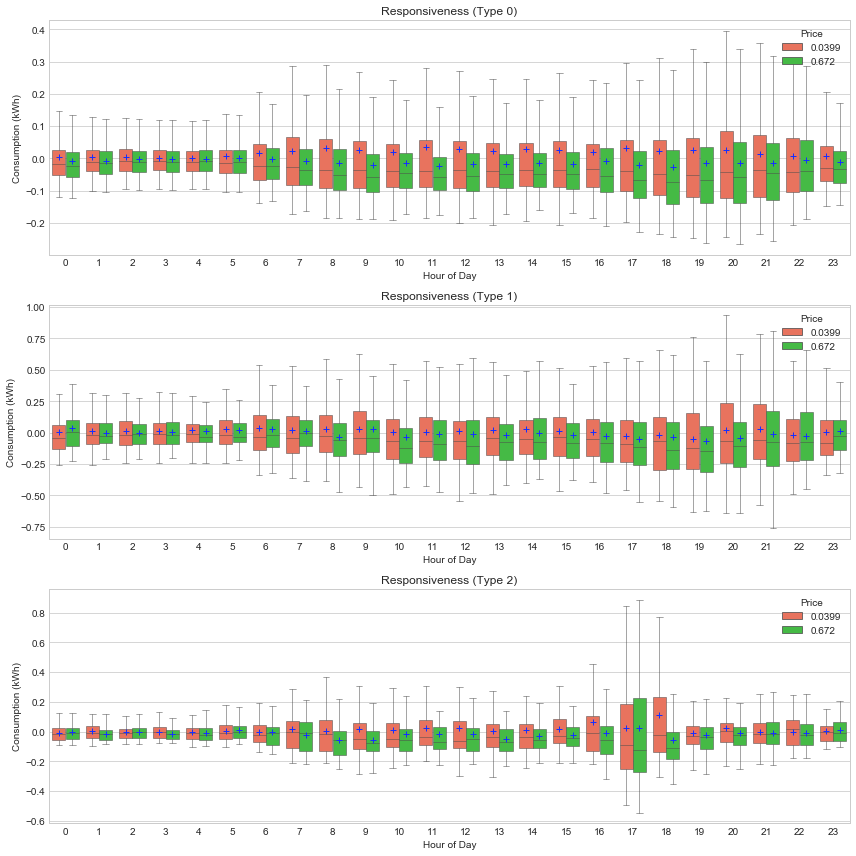

In [86]:
# price comparison
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,12))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for g in range(3): # three types
    ax_Ntou.append(fig_all.add_subplot(3, 1, (g + 1)))
    df_hour = df_all_res_long[df_all_res_long['Household type'] == g]
    if df_hour.shape[0] >= 1:
        sns.boxplot(x="Hour of day", y="Consumption", hue="Price", data=df_hour, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
        ax_Ntou[-1].set_title('Responsiveness'  + ' (Type ' + str(g) + ')' )
        ax_Ntou[-1].set_xlabel(r'Hour of Day')
        ax_Ntou[-1].set_ylabel('Consumption (kWh)')
        l = ax_Ntou[-1].legend()
#         ax_Ntou[-1].yaxis.grid(True)
#         ax_Ntou[-1].xaxis.grid(True)
        l.set_title('Price')
        for i,artist in enumerate(ax_Ntou[-1].artists):
            artist.set_linewidth(0.5)
            # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
            # Loop over them here, and use the same colour as above
            for j in range(i*6,i*6+6):
                line = ax_Ntou[-1].lines[j]
                line.set_linewidth(0.5) 
        ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

In a day, for low price, the max price responsivenss happens around 5pm - 8pm; for high price the max responsiveness happens around 1pm and 5pm or 9pm.

Midnight doesn't have too much responsiveness potential. Also high price has more impact on the median behvaior for all household groups.

Type 0 is ideal candidate for DR, type1 and 2 could be if design appropriately.

g) Temperature: prices

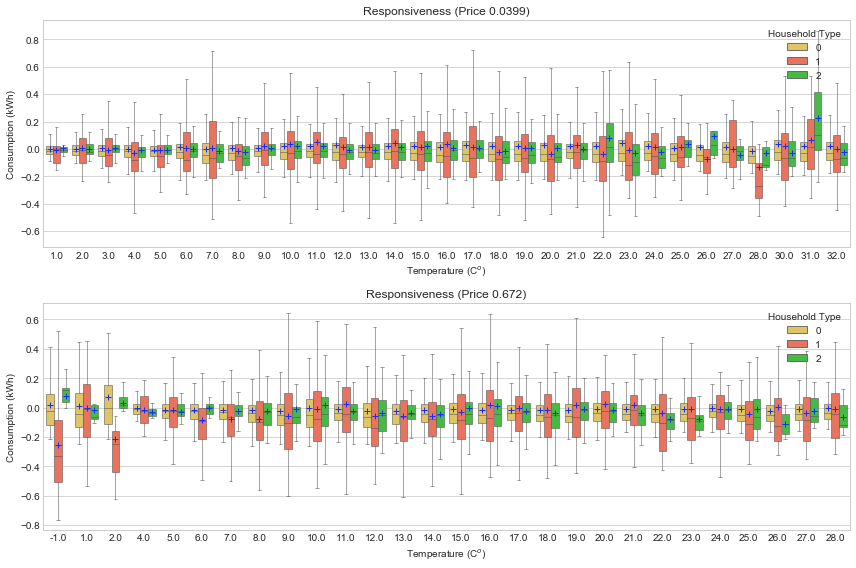

In [87]:
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,8))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for p in range(2): # two price levels
    ax_Ntou.append(fig_all.add_subplot(2, 1, (p + 1)))
    df_temp = df_all_res_long[df_all_res_long['Price'] == prices[p]]
    if df_temp.shape[0] >= 1:
        sns.boxplot(x="TempC", y="Consumption", hue="Household type", data=df_temp, ax=ax_Ntou[-1], palette=['xkcd:maize','tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
        ax_Ntou[-1].set_title('Responsiveness'  + ' (Price ' + str(prices[p]) + ')' )
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Consumption (kWh)')
#         ax_Ntou[-1].set(ylim = (-1.6, 1.6))
#         ax_Ntou[-1].yaxis.grid(True)
#         ax_Ntou[-1].xaxis.grid(True)
        l = ax_Ntou[-1].legend()
        l.set_title('Household Type')
        for i,artist in enumerate(ax_Ntou[-1].artists):
            artist.set_linewidth(0.5)
            # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
            # Loop over them here, and use the same colour as above
            for j in range(i*6,i*6+6):
                line = ax_Ntou[-1].lines[j]
                line.set_linewidth(0.5)    
        ax_Ntou[-1].legend(loc = 'upper right').set_title('Household Type')
plt.tight_layout()

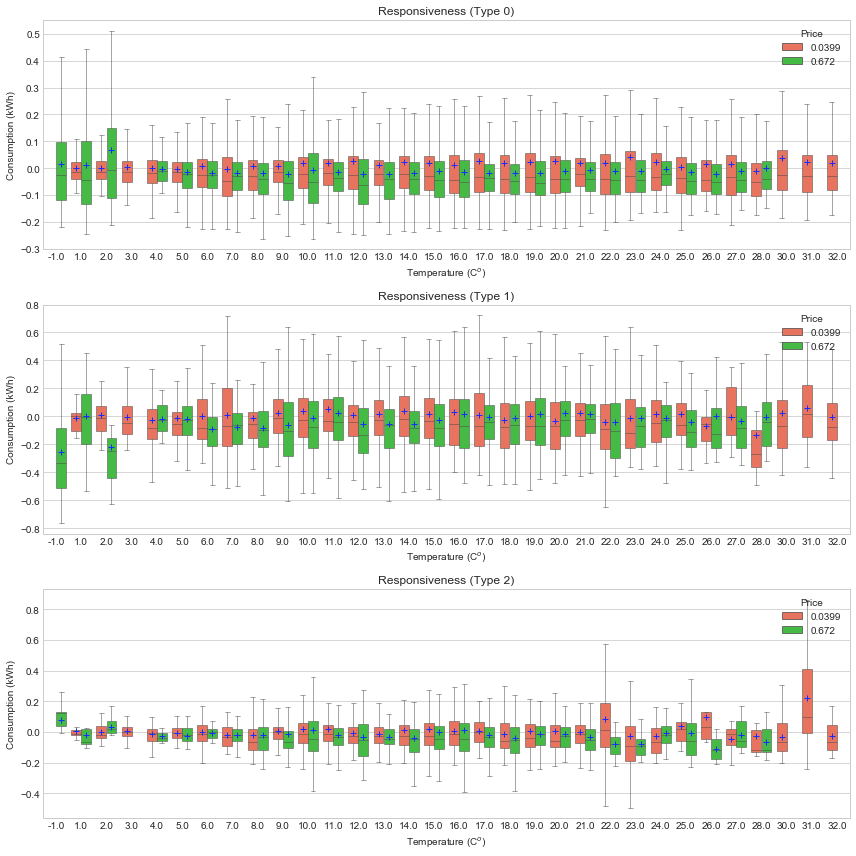

In [88]:
# price comparison
# price responsiveness under different tempertures over days of week and prices
fig_all = plt.figure(figsize = (12,12))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.6720]
sns.set_style("whitegrid")
for g in range(3): # three types
    ax_Ntou.append(fig_all.add_subplot(3, 1, (g + 1)))
    df_temp = df_all_res_long[df_all_res_long['Household type'] == g]
    if df_temp.shape[0] >= 1:
        sns.boxplot(x="TempC", y="Consumption", hue="Price", data=df_temp, ax=ax_Ntou[-1], palette=['tomato','limegreen'], showfliers = False, showmeans=True, meanprops={"marker":"+","markerfacecolor":"xkcd:vivid blue", "markeredgecolor":"xkcd:vivid blue"})
        ax_Ntou[-1].set_title('Responsiveness'  + ' (Type ' + str(g) + ')' )
        ax_Ntou[-1].set_xlabel(r'Temperature (C$^o$)')
        ax_Ntou[-1].set_ylabel('Consumption (kWh)')
#         ax_Ntou[-1].set(ylim = (-1.6, 1.6))
#         ax_Ntou[-1].yaxis.grid(True)
#         ax_Ntou[-1].xaxis.grid(True)
        l = ax_Ntou[-1].legend()
        l.set_title('Price')
        for i,artist in enumerate(ax_Ntou[-1].artists):
            artist.set_linewidth(0.5)
            # Each box has 6 associated Line2D objects (to make the whiskers, fliers, etc.)
            # Loop over them here, and use the same colour as above
            for j in range(i*6,i*6+6):
                line = ax_Ntou[-1].lines[j]
                line.set_linewidth(0.5)    
        ax_Ntou[-1].legend(loc = 'upper right').set_title('Price')
plt.tight_layout()

Compare to other temperatures, -1 & 2 celcius degrees for type 1 and 31 celcius degree for type 2 have some obvious impact, so when design DR program the temperature impact should be considered.

### Additional info
Consumption variance of different type of households over 24 hours (Warm Season). 

In [60]:
# type 0 event time consumption prediction
pred_result = []
for i in range(df_type0.shape[0]):
    pred_result.append(predict(df_regression_0, df_type0['Day of week'].iloc[i], df_type0['Hour of day'].iloc[i], df_type0['TempC'].iloc[i]))
df_type0['Predicted consumption'] = pred_result
# price responsiveness elementwise
df_type0_con = df_type0.copy() # store the consumption not the response, just for this additional test
# df_type0_con.iloc[:,1:houseGroupDf.counts.iloc[0] + 1] = df_type0.iloc[:,1:houseGroupDf.counts.iloc[0] + 1].sub(df_type0['Predicted consumption'], axis = 0)

# type 1 event time consumption prediction
pred_result = []
for i in range(df_type1.shape[0]):
    pred_result.append(predict(df_regression_1, df_type1['Day of week'].iloc[i], df_type1['Hour of day'].iloc[i], df_type1['TempC'].iloc[i]))
df_type1['Predicted consumption'] = pred_result

# price responsiveness elementwise
df_type1_con = df_type1.copy()
# df_type1_con.iloc[:,1:houseGroupDf.counts.iloc[1] + 1] = df_type1.iloc[:,1:houseGroupDf.counts.iloc[1] + 1].sub(df_type1['Predicted consumption'], axis = 0)

# type 2 event time consumption prediction
pred_result = []
for i in range(df_type2.shape[0]):
    pred_result.append(predict(df_regression_2, df_type2['Day of week'].iloc[i], df_type2['Hour of day'].iloc[i], df_type2['TempC'].iloc[i]))
df_type2['Predicted consumption'] = pred_result

# price responsiveness elementwise
df_type2_con = df_type2.copy()
# df_type2_con.iloc[:,1:houseGroupDf.counts.iloc[2] + 1] = df_type2.iloc[:,1:houseGroupDf.counts.iloc[2] + 1].sub(df_type2['Predicted consumption'], axis = 0)

In [61]:
df_type0

,GMT,D0000,D0001,D0005,D0007,D0010,D0012,D0013,D0016,D0018,...,D1023,D1024,TempC,TempF,Price,Event_tags,Day of week,Hour of day,Household type,Predicted consumption
0,2013-04-05 19:00:00,0.462,0.270,0.555,0.408,0.000,0.396,0.953,0.425,0.045,...,0.215,0.461,2.333333,36.333333,0.6720,H3,4,19,0,0.243337
1,2013-04-05 20:00:00,0.399,0.306,0.525,0.260,0.000,0.190,0.354,0.435,0.040,...,0.199,0.214,0.666667,33.666667,0.6720,H3,4,20,0,0.270188
2,2013-04-05 21:00:00,0.366,0.256,0.533,0.269,0.001,0.143,0.369,0.259,0.053,...,0.136,0.179,-1.000000,31.000000,0.6720,H3,4,21,0,0.237944
3,2013-04-08 10:00:00,0.587,0.228,0.439,0.441,0.000,0.305,0.143,0.071,0.099,...,0.098,0.120,8.000000,46.333333,0.6720,H3,0,10,0,0.202466
4,2013-04-08 11:00:00,0.384,0.138,0.447,2.823,0.000,0.151,0.254,0.071,0.091,...,0.040,0.095,9.000000,47.666667,0.6720,H3,0,11,0,0.203218
5,2013-04-08 12:00:00,0.369,0.163,0.201,0.302,0.001,0.870,0.131,0.071,0.059,...,0.047,0.085,10.000000,49.000000,0.6720,H3,0,12,0,0.217232
6,2013-04-11 01:00:00,0.097,0.072,0.147,0.170,0.001,0.139,0.089,0.074,0.052,...,0.116,0.138,4.333333,39.333333,0.6720,H3,3,1,0,0.109336
7,2013-04-11 02:00:00,0.111,0.119,0.138,0.146,0.000,0.135,0.093,0.072,0.083,...,0.048,0.107,4.666667,39.666667,0.6720,H3,3,2,0,0.104794
8,2013-04-11 03:00:00,0.113,0.061,0.150,0.168,0.000,0.111,0.104,0.072,0.046,...,0.027,0.101,5.000000,40.000000,0.6720,H3,3,3,0,0.103372
9,2013-04-13 16:00:00,0.346,0.042,0.447,0.276,0.000,0.466,0.250,0.077,0.038,...,0.017,0.134,9.333333,48.666667,0.6720,H6,5,16,0,0.238432


In [62]:
# select each user ID and form a seperate dataframe
# first change all the user ID to "Consumption"
new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[0]):
    new_col.append('Consumption')
new_col = new_col + list(df_type0_con.columns)[-8:] # the new column names
df_type0_con.columns = new_col
df_all_con_long = pd.DataFrame()
for i in range(1, houseGroupDf.counts.iloc[0] + 1):
    df_all_con_long = df_all_con_long.append(df_type0_con.iloc[:,[0,i,-8,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[1]): # for renaming the second type
    new_col.append('Consumption')
new_col = new_col + list(df_type1_con.columns)[-8:] # the new column names
df_type1_con.columns = new_col
for i in range(1, houseGroupDf.counts.iloc[1] + 1):
    df_all_con_long = df_all_con_long.append(df_type1_con.iloc[:,[0,i,-8,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[2]): # for renaming the third type
    new_col.append('Consumption')
new_col = new_col + list(df_type2_con.columns)[-8:] # the new column names
df_type2_con.columns = new_col
for i in range(1, houseGroupDf.counts.iloc[2] + 1):
    df_all_con_long = df_all_con_long.append(df_type2_con.iloc[:,[0,i,-8,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

# for clearer visulization, round the temperatures
df_all_con_long['TempC'] = df_all_con_long.TempC.round(0)
df_all_con_long['TempF'] = df_all_con_long.TempF.round(0)
df_all_con_long # ready for the price responsiveness analysis

,GMT,Consumption,TempC,TempF,Price,Event_tags,Day of week,Hour of day,Household type,Predicted consumption
0,2013-04-05 19:00:00,0.462,2.0,36.0,0.6720,H3,4,19,0,0.243337
1,2013-04-05 20:00:00,0.399,1.0,34.0,0.6720,H3,4,20,0,0.270188
2,2013-04-05 21:00:00,0.366,-1.0,31.0,0.6720,H3,4,21,0,0.237944
3,2013-04-08 10:00:00,0.587,8.0,46.0,0.6720,H3,0,10,0,0.202466
4,2013-04-08 11:00:00,0.384,9.0,48.0,0.6720,H3,0,11,0,0.203218
5,2013-04-08 12:00:00,0.369,10.0,49.0,0.6720,H3,0,12,0,0.217232
6,2013-04-11 01:00:00,0.097,4.0,39.0,0.6720,H3,3,1,0,0.109336
7,2013-04-11 02:00:00,0.111,5.0,40.0,0.6720,H3,3,2,0,0.104794
8,2013-04-11 03:00:00,0.113,5.0,40.0,0.6720,H3,3,3,0,0.103372
9,2013-04-13 16:00:00,0.346,9.0,49.0,0.6720,H6,5,16,0,0.238432


In [63]:
 # variance of type 0, 1, 2
var_type0_high = []
var_type1_high = []
var_type2_high = []
var_type0_low = []
var_type1_low = []
var_type2_low = []
for i in range(24):
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 0) & (df_all_con_long['Price'] == 0.6720)]
    var_type0_high.append(df_hour_con_long['Consumption'].std())
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 0) & (df_all_con_long['Price'] == 0.0399)]
    var_type0_low.append(df_hour_con_long['Consumption'].std())
for i in range(24):
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 1) & (df_all_con_long['Price'] == 0.6720)]
    var_type1_high.append(df_hour_con_long['Consumption'].std())
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 1) & (df_all_con_long['Price'] == 0.0399)]
    var_type1_low.append(df_hour_con_long['Consumption'].std())
for i in range(24):
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 2) & (df_all_con_long['Price'] == 0.6720)]
    var_type2_high.append(df_hour_con_long['Consumption'].std())
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 2) & (df_all_con_long['Price'] == 0.0399)]
    var_type2_low.append(df_hour_con_long['Consumption'].std())

Now we get the standard deviation of all type housholds in different pricing over 24 hours.

In [65]:
# non-event data
# Type 0 household
# build a new dataframe with columns: GMT, user ids in the group
df_type0_nf = df_tou1h_nf_warm[['GMT'] + list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[0]].House)]
df_type0_nf = pd.merge(df_type0_nf, df_wea1h_nf_warm, on = 'GMT') # add weather
df_type0_nf['Price'] = 0.1176
df_type0_nf['Day of week'] = pd.to_datetime(df_type0_nf.GMT).dt.dayofweek # add day of week
df_type0_nf['Hour of day'] = pd.to_datetime(df_type0_nf.GMT).dt.hour # add hour of day
df_type0_nf['Household type'] = 0

# Type 1 household
# build a new dataframe with columns: GMT, user ids in the group
df_type1_nf = df_tou1h_nf_warm[['GMT'] + list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[1]].House)]
df_type1_nf = pd.merge(df_type1_nf, df_wea1h_nf_warm, on = 'GMT') # add weather
df_type1_nf['Price'] = 0.1176
df_type1_nf['Day of week'] = pd.to_datetime(df_type1_nf.GMT).dt.dayofweek # add day of week
df_type1_nf['Hour of day'] = pd.to_datetime(df_type1_nf.GMT).dt.hour # add hour of day
df_type1_nf['Household type'] = 1

# Type 2 household
# build a new dataframe with columns: GMT, user ids in the group
df_type2_nf = df_tou1h_nf_warm[['GMT'] + list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[2]].House)]
df_type2_nf = pd.merge(df_type2_nf, df_wea1h_nf_warm, on = 'GMT') # add weather
df_type2_nf['Price'] = 0.1176
df_type2_nf['Day of week'] = pd.to_datetime(df_type2_nf.GMT).dt.dayofweek # add day of week
df_type2_nf['Hour of day'] = pd.to_datetime(df_type2_nf.GMT).dt.hour # add hour of day
df_type2_nf['Household type'] = 2

In [66]:
# add dummy column to use code in the next cell
# type 0 event time consumption prediction
df_type0_nf['Predicted consumption'] = 0
# price responsiveness elementwise
df_type0_con_nf = df_type0_nf.copy() # store the consumption not the response, just for this additional test
# df_type0_con.iloc[:,1:houseGroupDf.counts.iloc[0] + 1] = df_type0.iloc[:,1:houseGroupDf.counts.iloc[0] + 1].sub(df_type0['Predicted consumption'], axis = 0)

# type 1 event time consumption prediction
df_type1_nf['Predicted consumption'] = 0
# price responsiveness elementwise
df_type1_con_nf = df_type1_nf.copy()
# df_type1_nf_con.iloc[:,1:houseGroupDf.counts.iloc[1] + 1] = df_type1_nf.iloc[:,1:houseGroupDf.counts.iloc[1] + 1].sub(df_type1_nf['Predicted consumption'], axis = 0)

# type 2 event time consumption prediction
df_type2_nf['Predicted consumption'] = 0
# price responsiveness elementwise
df_type2_con_nf = df_type2_nf.copy()
# df_type2_con.iloc[:,1:houseGroupDf.counts.iloc[2] + 1] = df_type2.iloc[:,1:houseGroupDf.counts.iloc[2] + 1].sub(df_type2['Predicted consumption'], axis = 0)

In [67]:
# select each user ID and form a seperate dataframe
# first change all the user ID to "Consumption"
new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[0]):
    new_col.append('Consumption')
new_col = new_col + list(df_type0_con_nf.columns)[-7:] # the new column names
df_type0_con_nf.columns = new_col
df_all_con_long = pd.DataFrame()
for i in range(1, houseGroupDf.counts.iloc[0] + 1):
    df_all_con_long = df_all_con_long.append(df_type0_con_nf.iloc[:,[0,i,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[1]): # for renaming the second type
    new_col.append('Consumption')
new_col = new_col + list(df_type1_con_nf.columns)[-7:] # the new column names
df_type1_con_nf.columns = new_col
for i in range(1, houseGroupDf.counts.iloc[1] + 1):
    df_all_con_long = df_all_con_long.append(df_type1_con_nf.iloc[:,[0,i,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

new_col = ['GMT']
for i in range(0, houseGroupDf.counts.iloc[2]): # for renaming the third type
    new_col.append('Consumption')
new_col = new_col + list(df_type2_con_nf.columns)[-7:] # the new column names
df_type2_con_nf.columns = new_col
for i in range(1, houseGroupDf.counts.iloc[2] + 1):
    df_all_con_long = df_all_con_long.append(df_type2_con_nf.iloc[:,[0,i,-7,-6,-5,-4,-3,-2,-1]], ignore_index = True)

# for clearer visulization, round the temperatures
df_all_con_long['TempC'] = df_all_con_long.TempC.round(0)
df_all_con_long['TempF'] = df_all_con_long.TempF.round(0)
df_all_con_long # ready for the price responsiveness analysis

,GMT,Consumption,TempC,TempF,Price,Day of week,Hour of day,Household type,Predicted consumption
0,2013-04-01 00:00:00,0.110,-3.0,27.0,0.1176,0,0,0,0
1,2013-04-01 01:00:00,0.063,-3.0,27.0,0.1176,0,1,0,0
2,2013-04-01 02:00:00,0.115,-3.0,27.0,0.1176,0,2,0,0
3,2013-04-01 03:00:00,0.204,-3.0,27.0,0.1176,0,3,0,0
4,2013-04-01 04:00:00,0.124,-3.0,27.0,0.1176,0,4,0,0
5,2013-04-01 05:00:00,0.084,-2.0,28.0,0.1176,0,5,0,0
6,2013-04-01 06:00:00,0.062,-2.0,28.0,0.1176,0,6,0,0
7,2013-04-01 07:00:00,0.109,0.0,32.0,0.1176,0,7,0,0
8,2013-04-01 08:00:00,0.062,2.0,35.0,0.1176,0,8,0,0
9,2013-04-01 09:00:00,0.110,4.0,39.0,0.1176,0,9,0,0


In [68]:
 # variance of type 0, 1, 2
var_type0_default = []
var_type1_default = []
var_type2_default = []
for i in range(24):
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 0) & (df_all_con_long['Price'] == 0.1176)]
    var_type0_default.append(df_hour_con_long['Consumption'].std())
for i in range(24):
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 1) & (df_all_con_long['Price'] == 0.1176)]
    var_type1_default.append(df_hour_con_long['Consumption'].std())
for i in range(24):
    df_hour_con_long = df_all_con_long[(df_all_con_long['Hour of day'] == i) & (df_all_con_long['Household type'] == 2) & (df_all_con_long['Price'] == 0.1176)]
    var_type2_default.append(df_hour_con_long['Consumption'].std())

In [ ]:
# plot the grouped bar charts based on price, for 3 household types
fig_all = plt.figure(figsize = (12,12))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.1176, 0.6720]
# set width of bar
barWidth = 0.25
# Set position of bar on X axis
r1 = np.arange(len(var_type0_high))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
for g in range(3): # three types
    ax_Ntou.append(fig_all.add_subplot(3, 1, (g + 1)))
    # Make the plot
    if g == 0:
        ax_Ntou[-1].bar(r1, var_type0_low, color='tomato', width=barWidth, edgecolor='white', label='Low Price: 0.0399')
        ax_Ntou[-1].bar(r2, var_type0_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Default Price: 0.1176')
        ax_Ntou[-1].bar(r3, var_type0_high, color='limegreen', width=barWidth, edgecolor='white', label='High Price: 0.6720')
        ax_Ntou[-1].set_title('Type ' + str(g) + ' Household')
    if g == 1:
        ax_Ntou[-1].bar(r1, var_type1_low, color='tomato', width=barWidth, edgecolor='white', label='Low Price: 0.0399')
        ax_Ntou[-1].bar(r2, var_type1_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Default Price: 0.1176')
        ax_Ntou[-1].bar(r3, var_type1_high, color='limegreen', width=barWidth, edgecolor='white', label='High Price: 0.6720')
        ax_Ntou[-1].set_title('Type ' + str(g) + ' Household')
    if g == 2:
        ax_Ntou[-1].bar(r1, var_type2_low, color='tomato', width=barWidth, edgecolor='white', label='Low Price: 0.0399')
        ax_Ntou[-1].bar(r2, var_type2_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Default Price: 0.1176')
        ax_Ntou[-1].bar(r3, var_type2_high, color='limegreen', width=barWidth, edgecolor='white', label='High Price: 0.6720')
        ax_Ntou[-1].set_title('Type ' + str(g) + ' Household')
    ax_Ntou[-1].grid()
    ax_Ntou[-1].set_title('Responsiveness'  + ' (Type ' + str(g) + ')' )
    ax_Ntou[-1].set_xlabel('Hour of Day')
    ax_Ntou[-1].set_ylabel('Standard Deviation (kWh)')
    ax_Ntou[-1].legend()
plt.tight_layout()

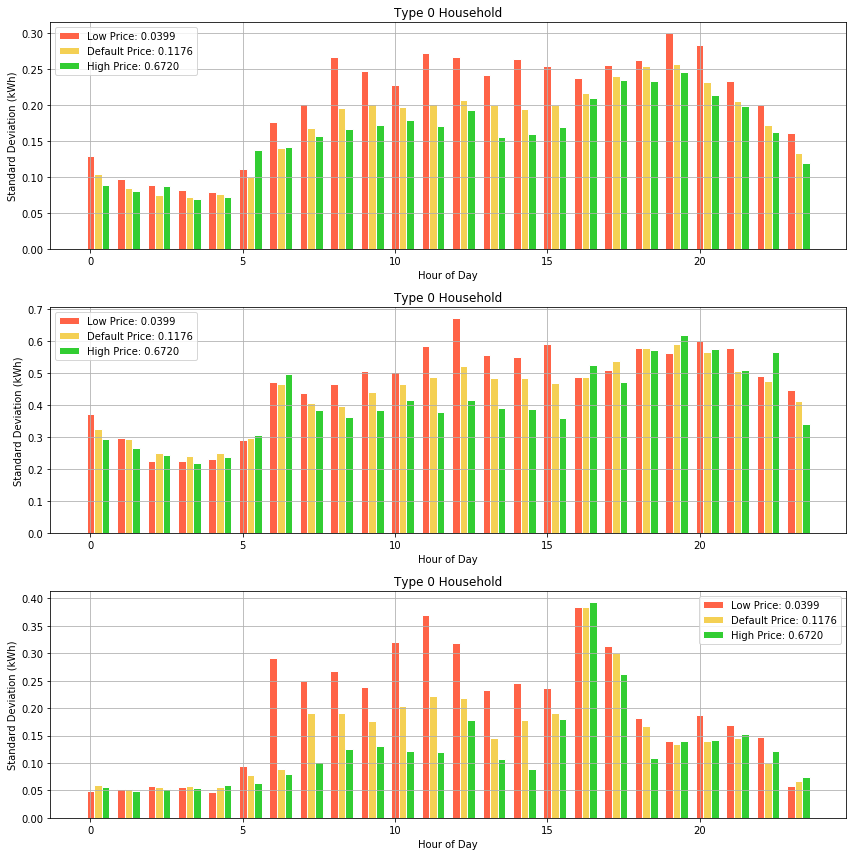

In [69]:
# plot the grouped bar charts based on price, for 3 household types
fig_all = plt.figure(figsize = (12,12))
ax_N'tou = [] # store subplot objects
prices = [0.0399, 0.1176, 0.6720]
# set width of bar
barWidth = 0.25
# Set position of bar on X axis
r1 = np.arange(len(var_type0_high))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
for g in range(3): # three types
    ax_Ntou.append(fig_all.add_subplot(3, 1, (g + 1)))
    # Make the plot
    if g == 0:
        ax_Ntou[-1].bar(r1, var_type0_low, color='tomato', width=barWidth, edgecolor='white', label='Low Price: 0.0399')
        ax_Ntou[-1].bar(r2, var_type0_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Default Price: 0.1176')
        ax_Ntou[-1].bar(r3, var_type0_high, color='limegreen', width=barWidth, edgecolor='white', label='High Price: 0.6720')
        ax_Ntou[-1].set_title('Type ' + str(g) + ' Household')
    if g == 1:
        ax_Ntou[-1].bar(r1, var_type1_low, color='tomato', width=barWidth, edgecolor='white', label='Low Price: 0.0399')
        ax_Ntou[-1].bar(r2, var_type1_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Default Price: 0.1176')
        ax_Ntou[-1].bar(r3, var_type1_high, color='limegreen', width=barWidth, edgecolor='white', label='High Price: 0.6720')
        ax_Ntou[-1].set_title('Type ' + str(g) + ' Household')
    if g == 2:
        ax_Ntou[-1].bar(r1, var_type2_low, color='tomato', width=barWidth, edgecolor='white', label='Low Price: 0.0399')
        ax_Ntou[-1].bar(r2, var_type2_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Default Price: 0.1176')
        ax_Ntou[-1].bar(r3, var_type2_high, color='limegreen', width=barWidth, edgecolor='white', label='High Price: 0.6720')
        ax_Ntou[-1].set_title('Type ' + str(g) + ' Household')
    ax_Ntou[-1].grid()
    ax_Ntou[-1].set_title('Responsiveness'  + ' (Type ' + str(g) + ')' )
    ax_Ntou[-1].set_xlabel('Hour of Day')
    ax_Ntou[-1].set_ylabel('Standard Deviation (kWh)')
    ax_Ntou[-1].legend()
plt.tight_layout()

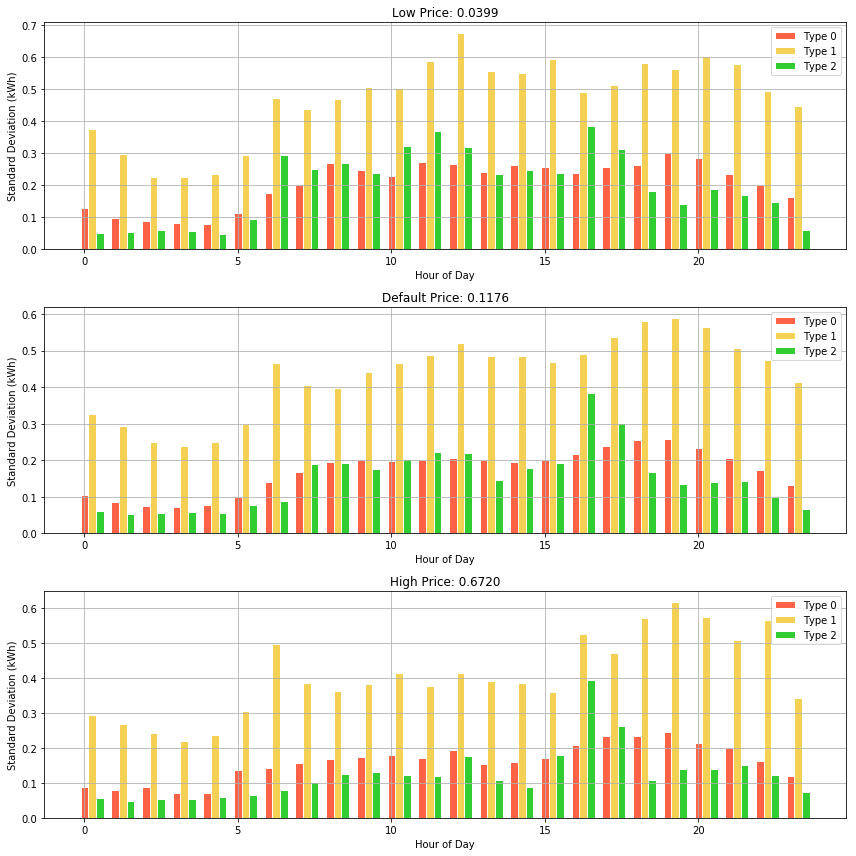

In [70]:
# plot the grouped bar charts based on price, for 3 household types
fig_all = plt.figure(figsize = (12,12))
ax_Ntou = [] # store subplot objects
prices = [0.0399, 0.1176, 0.6720]
# set width of bar
barWidth = 0.25
# Set position of bar on X axis
r1 = np.arange(len(var_type0_high))
r2 = [x + barWidth for x in r1]
r3 = [x + barWidth for x in r2]
for g in range(3): # three types
    ax_Ntou.append(fig_all.add_subplot(3, 1, (g + 1)))
    # Make the plot
    if g == 0:
        ax_Ntou[-1].bar(r1, var_type0_low, color='tomato', width=barWidth, edgecolor='white', label='Type 0')
        ax_Ntou[-1].bar(r2, var_type1_low, color='xkcd:maize', width=barWidth, edgecolor='white', label='Type 1')
        ax_Ntou[-1].bar(r3, var_type2_low, color='limegreen', width=barWidth, edgecolor='white', label='Type 2')
        ax_Ntou[-1].set_title('Low Price: 0.0399')
    if g == 1:
        ax_Ntou[-1].bar(r1, var_type0_default, color='tomato', width=barWidth, edgecolor='white', label='Type 0')
        ax_Ntou[-1].bar(r2, var_type1_default, color='xkcd:maize', width=barWidth, edgecolor='white', label='Type 1')
        ax_Ntou[-1].bar(r3, var_type2_default, color='limegreen', width=barWidth, edgecolor='white', label='Type 2')
        ax_Ntou[-1].set_title('Default Price: 0.1176')
    if g == 2:
        ax_Ntou[-1].bar(r1, var_type0_high, color='tomato', width=barWidth, edgecolor='white', label='Type 0')
        ax_Ntou[-1].bar(r2, var_type1_high, color='xkcd:maize', width=barWidth, edgecolor='white', label='Type 1')
        ax_Ntou[-1].bar(r3, var_type2_high, color='limegreen', width=barWidth, edgecolor='white', label='Type 2')
        ax_Ntou[-1].set_title('High Price: 0.6720')
    ax_Ntou[-1].grid()
    ax_Ntou[-1].set_xlabel('Hour of Day')
    ax_Ntou[-1].set_ylabel('Standard Deviation (kWh)')
    ax_Ntou[-1].legend()
plt.tight_layout()

### Compare the overlap of household types between two seasons

In [14]:
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from mpl_toolkits.mplot3d import Axes3D 
n = 3 # cluster numbers
n_house = 1025 # total household numbers
houseLabel = [] # store the 24hour group labels for each hoursehold
for i in range(1025):
    houseLabel.append('')
houseLabel = np.array(houseLabel)
cons_type = ['High Consumption', 'Medium Consumption', 'Low Consumption']
fig_all = plt.figure(figsize = (13,90))
for i in range(24):
    if i <= 9:
        x = df_tou1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains('0' + str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and fill in null value with mean
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
    else:
        x = df_tou1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains(str(i) + ':00:00')]
        x.set_index('GMT', inplace = True)
        x = x.fillna(x.mean()).transpose() # data for the specific hour, and filtering out null value
        # PCA without standardization
        pca_nstd = PCA()
        principleComponents_nstd = pca_nstd.fit_transform(x)
        principleDf_nstd = pd.DataFrame(data = principleComponents_nstd)
        kmeans = KMeans(n_clusters = n, init='k-means++').fit(principleDf_nstd.iloc[:,:3])
        cluster_dict = {}
        houseLabel = np.core.defchararray.add(houseLabel, kmeans.labels_.astype('str'))
# We obtain the house Label shown below
# print(houseLabel)

# Group the house based on their 24 hour labels
houseLableDf = pd.DataFrame()
houseLableDf['House'] = df_tou1h_nf_cold.columns[1:]
houseLableDf['Label'] = houseLabel
houseGroupDf = houseLableDf.groupby('Label').size().reset_index(name='counts')
houseGroupDf = houseGroupDf.sort_values(by=['counts'], ascending=False)
houseGroupDf

,Label,counts
37,011000000001000011000201,411
297,100211121112122100122020,29
27,011000000001000010000201,10
97,011000000101000011000201,8
43,011000000001000011020201,7
160,011000001112122100122020,7
49,011000000001000011100201,6
319,101000000001000011000201,5
435,222122212220211222211112,5
287,100211101112122100122020,5


<Figure size 936x6480 with 0 Axes>

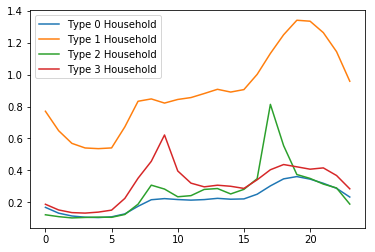

In [15]:
for i in range(4):
    load = []
    for j in range(24):
        if j <= 9:
            x = df_tou1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains('0' + str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
        else:
            x = df_tou1h_nf_cold[df_tou1h_nf_cold.GMT.str.contains(str(j) + ':00:00')]
            x.set_index('GMT', inplace = True)
            x = x.fillna(x.mean())
            x = x[list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[i]].House)]
            load.append(x.mean().mean())
    plt.plot(load, label = 'Type ' + str(i) + ' Household')
plt.legend()
plt.show()

In [16]:
# Store warm season houshold labels
house_list_type0_warm = list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[0]].House)
house_list_type1_warm = list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[1]].House)
house_list_type2_warm = list(houseLableDf[houseLableDf.Label == houseGroupDf.Label.iloc[2]].House)

In [17]:
len(house_list_type0)

314

In [18]:
len(house_list_type0_warm)

411

In [20]:
len(set(house_list_type0) & set(house_list_type0_warm))

292

In [21]:
292/314*100

92.99363057324841

In [22]:
292/411*100

71.04622871046229

In [23]:
len(set(house_list_type1) & set(house_list_type1_warm))

5

In [24]:
len(house_list_type1)

19

In [25]:
len(house_list_type1_warm)

29

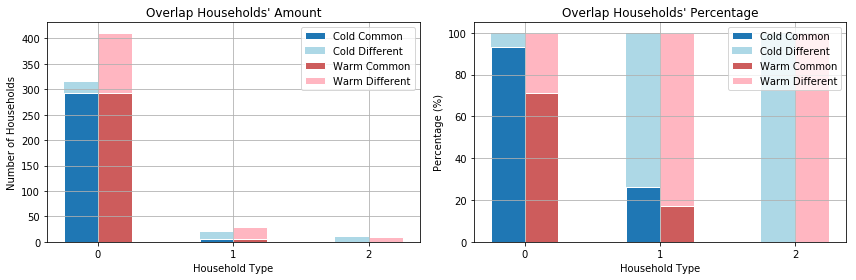

In [55]:
# plot the grouped bar charts based on price, for 3 household types
house_list_common_type0 = set(house_list_type0) & set(house_list_type0_warm)
house_list_common_type1 = set(house_list_type1) & set(house_list_type1_warm)
house_list_common_type2 = set(house_list_type2) & set(house_list_type2_warm)
house_amount_cold_base = [len(house_list_common_type0), len(house_list_common_type1), len(house_list_common_type2)] # type0, type1, type2 
house_amount_cold_top = [len(house_list_type0)-len(house_list_common_type0), len(house_list_type1)-len(house_list_common_type1), len(house_list_type2)-len(house_list_common_type2)] # type0, type1, type2 
house_amount_warm_base = [len(house_list_common_type0), len(house_list_common_type1), len(house_list_common_type2)] # type0, type1, type2 
house_amount_warm_top = [len(house_list_type0_warm)-len(house_list_common_type0), len(house_list_type1_warm)-len(house_list_common_type1), len(house_list_type2_warm)-len(house_list_common_type2)] # type0, type1, type2 
# percentage
house_amount_cold_base_per = [len(house_list_common_type0)/len(house_list_type0)*100, len(house_list_common_type1)/len(house_list_type1)*100, len(house_list_common_type2)/len(house_list_type2)*100] # type0, type1, type2 
house_amount_cold_top_per = [(len(house_list_type0)-len(house_list_common_type0))/len(house_list_type0)*100, (len(house_list_type1)-len(house_list_common_type1))/len(house_list_type1)*100, (len(house_list_type2)-len(house_list_common_type2))/len(house_list_type2)*100] # type0, type1, type2 
house_amount_warm_base_per = [len(house_list_common_type0)/len(house_list_type0_warm)*100, len(house_list_common_type1)/len(house_list_type1_warm)*100, len(house_list_common_type2)/len(house_list_type2_warm)*100] # type0, type1, type2 
house_amount_warm_top_per = [(len(house_list_type0_warm)-len(house_list_common_type0))/len(house_list_type0_warm)*100, (len(house_list_type1_warm)-len(house_list_common_type1))/len(house_list_type1_warm)*100, (len(house_list_type2_warm)-len(house_list_common_type2))/len(house_list_type2_warm)*100] # type0, type1, type2
fig_all = plt.figure(figsize = (12,4))
ax_Ntou = [] # store subplot objects
# set width of bar
barWidth = 0.25
# Set position of bar on X axis
r1 = np.arange(3) - 0.125
r2 = [x + barWidth for x in r1]
for g in range(2): # three types
    ax_Ntou.append(fig_all.add_subplot(1, 2, (g + 1)))
    # Make the plot
    if g == 0:
        ax_Ntou[-1].bar(r1, house_amount_cold_base, width=barWidth, edgecolor='white', label='Cold Common')
        ax_Ntou[-1].bar(r1, house_amount_cold_top, color='lightblue', width=barWidth, bottom=house_amount_cold_base, label='Cold Different')
        ax_Ntou[-1].bar(r2, house_amount_warm_base, color='indianred', width=barWidth, edgecolor='white', label='Warm Common')
        ax_Ntou[-1].bar(r2, house_amount_warm_top, color='lightpink', width=barWidth, edgecolor='white', label='Warm Different', bottom=house_amount_cold_base)
        ax_Ntou[-1].set_title("Overlap Households' Amount")
        ax_Ntou[-1].set_ylabel('Number of Households')
    if g == 1:
        ax_Ntou[-1].bar(r1, house_amount_cold_base_per, width=barWidth, edgecolor='white', label='Cold Common')
        ax_Ntou[-1].bar(r1, house_amount_cold_top_per, color='lightblue', width=barWidth, bottom=house_amount_cold_base_per, label='Cold Different')
        ax_Ntou[-1].bar(r2, house_amount_warm_base_per, color='indianred', width=barWidth, edgecolor='white', label='Warm Common')
        ax_Ntou[-1].bar(r2, house_amount_warm_top_per, color='lightpink', width=barWidth, edgecolor='white', label='Warm Different', bottom=house_amount_warm_base_per)
        ax_Ntou[-1].set_title("Overlap Households' Percentage")
        ax_Ntou[-1].set_ylabel('Percentage (%)')
    ax_Ntou[-1].grid()
    ax_Ntou[-1].set_xticks([0,1,2])
    ax_Ntou[-1].set_xlabel('Household Type')
    ax_Ntou[-1].legend()
plt.tight_layout()

The above figure tells us, if we use cold season to do principle components clustering and use the clustered households in the warm season, we will have some households different from those clustered based on warm season data. Such difference percentage increases along type 0, 1, 2. For type 0, the overlap is actually more than 70% in both clustered type 0 using different season data, which could mean that if we want to decide the right consumer groups to target, and we could conduct experiment for the cold season, and use the group for the warm seaon in order save some experiment cost and computation time, if the error of mis clustering is acceptable.